<a href="https://colab.research.google.com/github/kothapalliAnusha/Equitable-AI-on-the-Road-Robust-Object-Detection-Under-Adverse-Conditions-with-Bias-Mitigation/blob/main/Equitable_AI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ***Equitable AI on the Road Robust Object Detection Under Adverse Conditions with Bias Mitigation***


"Equitable AI" instead of "Explainable AI" because your focus goes beyond just making the AI model's decisions understandable (explainability). Instead, you aim to ensure fairness and unbiased outcomes in the AI's predictions, especially under challenging conditions like adverse weather.


datasets: COCO-C, Pascal-C, and Cityscapes-C. Each dataset is a corrupted version of a standard dataset, designed to test how well models handle various types of image corruptions (e.g., noise, weather conditions, blur).

K

# Installing the Robustness Library

the robustness library, then imports essential packages like pickle, numpy, matplotlib, and seaborn for data analysis and visualization.

In [ ]:
!pip install robustness

# Installing Robustness Library Version 1.0

installs version 1.0 of the robustness library and uninstalls any existing version.

In [ ]:
!pip install robustness==1.0


# Importing Essential Libraries for Data Analysis

imports essential packages such as pickle, numpy, matplotlib.pyplot, and seaborn for data handling and visualization.

In [ ]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
from os.path import join as pjoin
import seaborn as sns

# Configuring Matplotlib for Inline Display

display Matplotlib plots inline with tight bounding boxes.

In [ ]:
%matplotlib inline
%config InlineBackend.print_figure_kwargs = {'bbox_inches':'tight'}


# Importing Functions from Robustness Evaluation Module

the get_results and get_distortions_from_file functions from the robustness_eval module while raising a syntax warning for an improper comparison.

In [ ]:
from robustness_eval import get_results, get_distortions_from_file

# Setting Result and Figures Directory Paths

The paths for the result directory and figures directory to organize output data.

In [ ]:
result_dir = "../raw-data/"
figures_dir = "../figures/results/"

In [ ]:
sns.set()
sns.set_style('ticks')
sns.set_context('paper',rc={"font.size":8,"axes.titlesize":8,"axes.labelsize":8})

# Defining Custom Colour Scheme for Plots

creates a custom color scheme for visualizations by normalizing RGB values from tuples to the range [0, 1].

In [ ]:
# Colour scheme

col_clean = tuple(x/255.0 for x in (50, 65, 75))
col_stylized = tuple(x/255.0 for x in (180, 160, 105))
col_combined = tuple(x/255.0 for x in (165, 30, 55))

In [ ]:
# plotting parameters

combined_plot_height = 7.0
combined_plot_width = 6.0

markersize = 16
fontsize = 24
linewidth = 2.5
labelsize = 18
legend_fontsize=18
axis_start = -0.2
axis_end = 5.3


# Plotting Individual Results for Various Data Sets

This function visualizes individual performance results of different data sets against corruption severity, with customizable plotting parameters for enhanced clarity.

In [ ]:
def plot_individual_results(data_A, data_B, data_C, plot_name, metric_name,
                            ylim, legend_loc=1, markersize=12, linewidth=2.0,
                            fontsize=15, legend_fontsize=11.3, labelsize=12.0,
                            data_name_A="standard data", data_name_B="stylized data",
                            data_name_C="combined data", color_A=col_clean,
                            color_B = col_stylized, color_C = col_combined):

    fig = plt.figure(figsize = (15.0, 20.0))
    plt.subplots_adjust(wspace = 0.3, hspace = 0.5)

    for i, distortion in enumerate(distortions[0:15]): # only plot first 15 distortions, not the validation distortions
        ax = plt.subplot(5,3,i+1)

        plt.plot(list(range(6)), data_A[i,:] * 100, 's-', zorder=2, color=color_A,
                 label=data_name_A, markersize=markersize, linewidth=linewidth)
        plt.plot(list(range(6)), data_B[i,:] * 100, '^-', zorder=1, color=color_B,
                 label=data_name_B, markersize=markersize, linewidth=linewidth)
        plt.plot(list(range(6)), data_C[i,:] * 100, 'o-', zorder=3, color=color_C,
                 label=data_name_C, markersize=markersize, linewidth=linewidth)


        plt.title(distortion, fontsize=fontsize)
        if i >= 12: # plot xlabel only in last row
            plt.xlabel('corruption severity', fontsize=fontsize)
        if i % 3 == 0:
            plt.ylabel(metric_name, fontsize=fontsize)
        plt.axis([axis_start, axis_end, ylim[0], ylim[1]])
        if i == 0:
            legend = plt.legend(loc=legend_loc, fontsize=legend_fontsize, frameon=True, edgecolor="black")
            legend.get_frame().set_linewidth(1.0)

        ax.tick_params(axis='both', which='major', labelsize=labelsize)


    sns.despine(trim=True, offset=5)

    plt.show()

    fig.savefig(pjoin(figures_dir, plot_name), bbox_inches='tight')


# Loading Distortions and Evaluating Model Results

Distortion data and evaluates model performance under corruption for multiple datasets using pre-saved results.

**Backbone (ResNet-50):** All models use a fixed ResNet-50 backbone to standardize the comparison and ensure that the robustness improvements are due to better training or model techniques, not simply a stronger feature extractor.

**mPC (mean Performance under Corruption)**: This is the primary metric used to rank models, indicating average performance across different corruptions. A higher mPC value reflects better robustness.

PASCAL_VOC DATASET

In [ ]:
distortions = get_distortions_from_file(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_voc0712_results.pkl"))
voc_results = get_results(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_voc0712_results.pkl"), dataset='voc')
svoc_results = get_results(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_svoc0712_results.pkl"), dataset='voc')
voc_svoc_results = get_results(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_vocsvoc0712_results.pkl"), dataset='voc')


model: faster_rcnn_r50_fpn_1x_voc0712_results.pkl
Mean Performance under Corruption [mPC] in AP50  = 0.486

model: faster_rcnn_r50_fpn_1x_svoc0712_results.pkl
Mean Performance under Corruption [mPC] in AP50  = 0.500

model: faster_rcnn_r50_fpn_1x_vocsvoc0712_results.pkl
Mean Performance under Corruption [mPC] in AP50  = 0.562


***Baseline Model (VOC):***
The mPC value of 0.486 indicates the performance of the model when trained on the original VOC dataset. It shows a moderate level of robustness but is likely to struggle under various distortions (e.g., noise, blur).
***Stylized VOC (sVOC) Model:***
The mPC value of 0.500 is slightly higher than the baseline. This improvement suggests that training on a stylized dataset like sVOC, which introduces diverse texture patterns, enhances the model’s ability to generalize better under texture-based corruptions.
***Combined Dataset (VOC + sVOC) Model:***
The highest mPC of 0.562 shows a significant improvement in robustness. This model benefits from exposure to both the original and stylized datasets, making it better at handling a wider range of distortions.

# Setting Font Sizes for Matplotlib Axes

This helper function uniformly sets the font size for axis titles and labels in Matplotlib plots for better readability.

In [ ]:
def set_fontsize_helper(ax, fontsize):

    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(fontsize)

# Averaged mAP50 Performance Plot for Pascal VOC

This plot visualizes the mean Average Precision at IoU 0.50 (mAP50) under varying corruption severities for standard, stylized, and combined datasets from Pascal VOC.

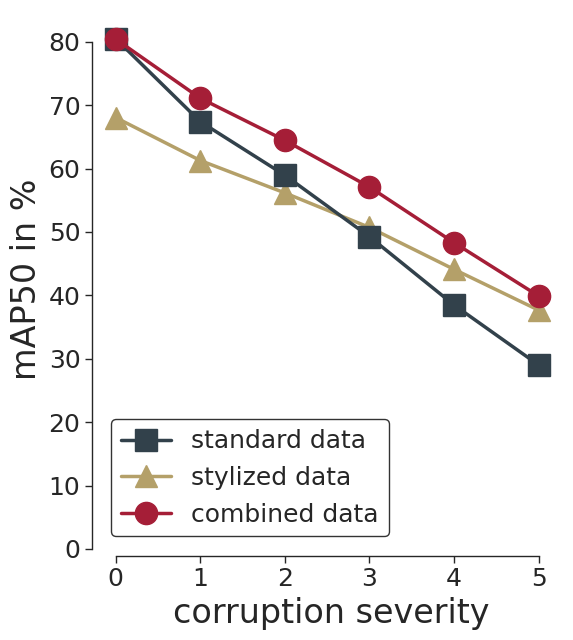

In [ ]:
# Pascal VOC combined=averaged plot

fig = plt.figure(figsize = (combined_plot_width, combined_plot_height))

ax = plt.subplot(1,1,1)
plt.plot(list(range(6)), np.mean(voc_results[:15,:], axis=0) * 100,
         's-', zorder=2, color=col_clean, label='standard data', markersize=markersize,
        linewidth=linewidth)
plt.plot(list(range(6)), np.mean(svoc_results[:15,:], axis=0) * 100,
         '^-', zorder=1, color=col_stylized, label='stylized data', markersize=markersize,
        linewidth=linewidth)
plt.plot(list(range(6)), np.mean(voc_svoc_results[:15,:], axis=0) * 100,
         'o-', zorder=3, color=col_combined, label='combined data', markersize=markersize,
        linewidth=linewidth)

plt.xlabel('corruption severity', fontsize=fontsize)
plt.ylabel('mAP50 in %', fontsize=fontsize)
plt.axis([axis_start, axis_end, 0, 85])
ax.tick_params(axis='both', which='major', labelsize=labelsize)
legend = plt.legend(loc=3, fontsize=legend_fontsize, frameon=True, edgecolor="black")
legend.get_frame().set_linewidth(1.0)

sns.despine(trim=True, offset=5)

plt.show()

fig.savefig(pjoin(figures_dir, '/content/pascal_corruption_overall.pdf'), bbox_inches='tight')

Training the model with a mix of standard and stylized data helps it generalize better to corrupted inputs, leading to improved performance across varying levels of image quality. This is crucial for applications like autonomous driving, where the environment can introduce unexpected visual challenges.

# Calling the Individual Results Plot Function

This function generates a detailed plot showing the mAP50 performance for each distortion on standard, stylized, and combined datasets from Pascal VOC, illustrating the impact of corruption severity on model performance.

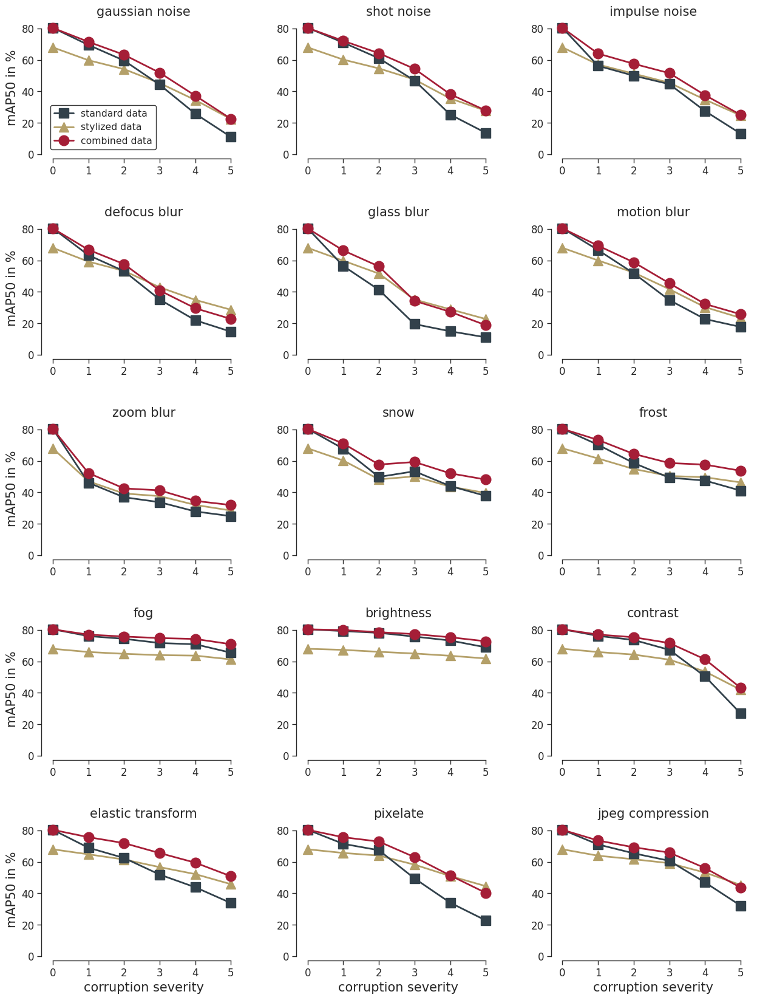

In [ ]:
plot_individual_results(data_A = voc_results,
                        data_B=svoc_results,
                        data_C=voc_svoc_results,
                        plot_name="/content/pascal_corruption_individual.pdf",
                        metric_name="mAP50 in %", ylim=[0, 85], legend_loc=3)

**Noise Corruptions:**
Gaussian Noise, Shot Noise, Impulse Noise: Random variations in pixel values, mimicking sensor or transmission noise.
**Blur Corruptions:**
Defocus Blur, Glass Blur, Motion Blur, Zoom Blur: Different types of image blurring, representing scenarios like camera shake or focus issues.
**Weather Corruptions:**
Snow, Frost, Fog: Simulate various weather conditions that could obscure the camera's view.
**Lighting Corruptions:**
Brightness, Contrast: Changes in lighting conditions, affecting image clarity.
**Transformation Corruptions:**
Elastic Transform, Pixelate: Deformations or pixelation that can distort the object’s appearance.
**Compression Corruption:**
JPEG Compression: Artifacts from lossy image compression.


# Installing Image Corruptions Package

The ImageCorruptions library is successfully installed, providing tools to simulate various image corruptions for robustness evaluation in computer vision tasks.

In [ ]:
!pip install imagecorruptions

# RMSE vs rPC Analysis for Different Corruption Types

The plot visualizes the relationship between RMSE values and relative performance change (rPC) across various image corruption types, highlighting the impact of noise, blur, weather, and digital artifacts on model performance.

In [ ]:
import csv
from imagecorruptions import get_corruption_names

corruption_names = get_corruption_names('all')

clean_performance = voc_results[0,0,0]
mean_voc_results = np.mean(voc_results[:15,1:,0], axis=1)
mean_voc_svoc_results = np.mean(voc_svoc_results[:15, 1:,0], axis=1)

rpc_voc_clean = mean_voc_results / clean_performance
rpc_voc_combined = mean_voc_svoc_results / clean_performance

# load the rmse values calculated with the calc_rmse.py script
rmse_voc = np.zeros((19, 5))
with open('/content/voc_rmse.csv') as f:
    reader = csv.DictReader(f)
    for rownum, row in enumerate(reader):
        corruption_number = corruption_names.index(row['corruption'])
        rmse_voc[corruption_number, int(row['severity']) - 1] = row['RMSE']

mean_rmse_voc = np.mean(rmse_voc, axis=1)

num_noise = 3
num_blur = 4
num_weather = 4
num_digital = 4
noise = np.array([145,105,70]) / 255.
blur = np.array([50, 110, 30]) / 255.
weather = np.array([80, 170, 200]) / 255.
digital = np.array([175, 110, 150]) / 255.

colors = [noise for _ in range(num_noise)] + [blur for _ in range(num_blur)] + [weather for _ in range(num_weather)] + [digital for _ in range(num_digital)]

# Plotting RMSE vs. Relative Performance Change (rPC)

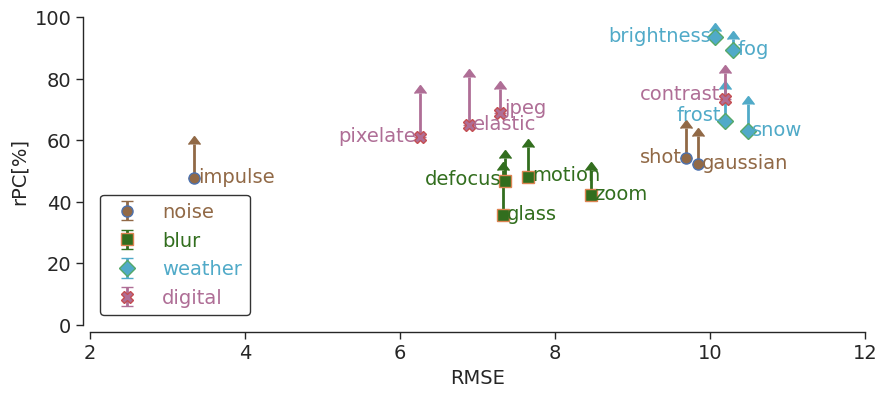

In [ ]:
fig = plt.figure(figsize = (10.0, 4.0))

ax = plt.subplot(1,1,1)

rmse_fontsize=14
rmse_linewidth=2
rmse_markersize=8
rmse_capsize=4

plt.axis([2, 12, 0, 100])
ax.tick_params(axis='both', which='major', labelsize=rmse_fontsize)

plt.xlabel('RMSE', fontsize=rmse_fontsize)
plt.ylabel('rPC[%]', fontsize=rmse_fontsize)
x = mean_rmse_voc
y = rpc_voc_clean * 100
ywhiskers = (rpc_voc_combined - rpc_voc_clean) * 100
xe = x[:num_noise]
ye = y[:num_noise]
ywe = ywhiskers[:num_noise]
# Use the built-in bool type instead of np.bool
lolims = np.ones(num_noise, dtype=bool)
uplims = np.zeros(num_noise, dtype=bool)
plt.errorbar(xe, ye, yerr=ywe, lolims=lolims, uplims=uplims, linestyle="None", ecolor=noise, marker='o', mfc=noise, linewidth=rmse_linewidth, markersize=rmse_markersize, capsize=rmse_capsize)

xe = x[num_noise:num_noise+num_blur]
ye = y[num_noise:num_noise+num_blur]
ywe = ywhiskers[num_noise:num_noise+num_blur]
# Use the built-in bool type instead of np.bool
lolims = np.ones(num_blur, dtype=bool)
uplims = np.zeros(num_blur, dtype=bool)
plt.errorbar(xe, ye, yerr=ywe, lolims=lolims, uplims=uplims, linestyle="None", ecolor=blur, marker='s', mfc=blur, linewidth=rmse_linewidth, markersize=rmse_markersize, capsize=rmse_capsize)

xe = x[num_noise+num_blur:num_noise+num_blur+num_weather]
ye = y[num_noise+num_blur:num_noise+num_blur+num_weather]
ywe = ywhiskers[num_noise+num_blur:num_noise+num_blur+num_weather]
# Use the built-in bool type instead of np.bool
lolims = np.ones(num_weather, dtype=bool)
uplims = np.zeros(num_weather, dtype=bool)
plt.errorbar(xe, ye, yerr=ywe, lolims=lolims, uplims=uplims, linestyle="None", ecolor=weather, marker='D', mfc=weather, linewidth=rmse_linewidth, markersize=rmse_markersize, capsize=rmse_capsize)

xe = x[num_noise+num_blur+num_weather:num_noise+num_blur+num_weather+num_digital]
ye = y[num_noise+num_blur+num_weather:num_noise+num_blur+num_weather+num_digital]
ywe = ywhiskers[num_noise+num_blur+num_weather:num_noise+num_blur+num_weather+num_digital]
# Use the built-in bool type instead of np.bool
lolims = np.ones(num_digital, dtype=bool)
uplims = np.zeros(num_digital, dtype=bool)
plt.errorbar(xe, ye, yerr=ywe, lolims=lolims, uplims=uplims, linestyle="None", ecolor=digital, marker='X', mfc=digital, linewidth=rmse_linewidth, markersize=rmse_markersize, capsize=rmse_capsize)

# ... (rest of the code remains the same)

text_offsets = [
    (4, -4), # gaussian noise 0
    (-4, -4), # shot noise 1
    (4, -4), # impulse noise 2
    (-4, -4), # defocus blur 3
    (4, -4), # glass blur 4
    (4, -4), # motion blur 5
    (4, -4), # zoom blur 6
    (4, -4), # snow 7
    (-4, 0), # frost 8
    (4, -4), # fog 9
    (-4, -4), # brightness 10
    (-4, 0), # contrast 11
    (4, -4), # elastic transform 12
    (-4, -4), # pixelate 13
    (4, 0), # jpeg_compression 14
]

annotations = [
    'gaussian',
    'shot',
    'impulse',
    'defocus',
    'glass',
    'motion',
    'zoom',
    'snow',
    'frost',
    'fog',
    'brightness',
    'contrast',
    'elastic',
    'pixelate',
    'jpeg'
]

ha = [
    'left',
    'right',
    'left',
    'right',
    'left',
    'left',
    'left',
    'left',
    'right',
    'left',
    'right',
    'right',
    'left',
    'right',
    'left',
]
ax = plt.gca()
for c in range(15):
    ax.annotate(annotations[c], (x[c], y[c]), xytext=text_offsets[c], textcoords='offset pixels', fontsize=rmse_fontsize, ha = ha[c], color=colors[c])

legend = plt.legend(['noise', 'blur', 'weather', 'digital'], loc='lower left', fontsize=rmse_fontsize, frameon=True, edgecolor="black")
for text, color in zip(legend.get_texts(), [noise, blur, weather, digital]):
    plt.setp(text, color=color)
legend.get_frame().set_linewidth(1.0)

sns.despine(trim=True, offset=5)

plt.show()
fig.savefig(pjoin(figures_dir, "/content/rpc_vs_rmse.pdf"), bbox_inches='tight')

The **x-axis (RMSE**) represents the error introduced by each type of corruption.
The **y-axis (rPC)** shows the percentage change in relative performance due to the corruption.

# Mean Average Precision (AP) Results for Faster R-CNN Models Under Corruption(COCO DATASET)

---



---




It represents the mean performance under corruption for three Faster R-CNN models, showing AP values of 0.182, 0.141, and 0.204 for the COCO, SCoco, and COCO+SCoco datasets, respectively.

In [ ]:
distortions = get_distortions_from_file(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_coco_results.pkl"))
coco_results = get_results(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_coco_results.pkl"), metric='AP')
scoco_results = get_results(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_scoco_results.pkl"), metric='AP')
coco_scoco_results = get_results(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_cocoscoco_results.pkl"), metric='AP')


model: faster_rcnn_r50_fpn_1x_coco_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.182

model: faster_rcnn_r50_fpn_1x_scoco_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.141

model: faster_rcnn_r50_fpn_1x_cocoscoco_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.204


# Mean Average Precision (mAP) Comparison for COCO and Stylized COCO Under Corruption

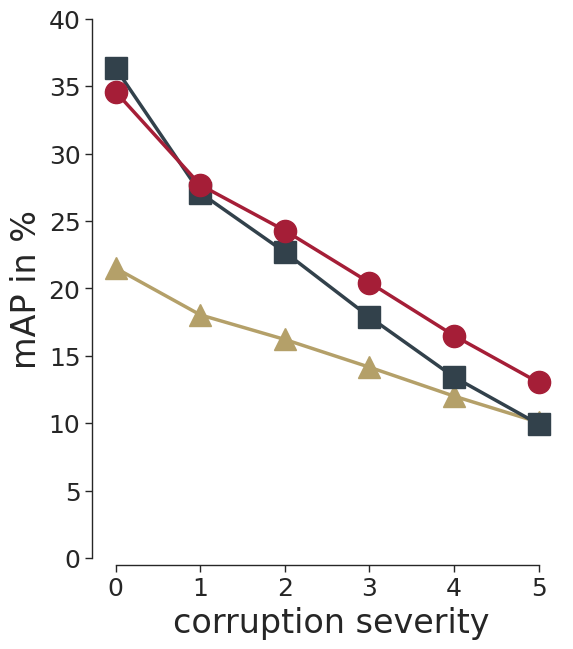

In [ ]:
# MS COCO combined results

fig = plt.figure(figsize = (combined_plot_width, combined_plot_height))

ax = plt.subplot(1,1,1)

plt.plot(list(range(6)), np.mean(coco_results[:15,:], axis=0) * 100,
         's-', zorder=2, color=col_clean, label='coco', markersize=markersize,
        linewidth=linewidth)
plt.plot(list(range(6)), np.mean(scoco_results[:15,:], axis=0) * 100,
         '^-', zorder=1, color=col_stylized, label='stylized coco', markersize=markersize,
        linewidth=linewidth)
plt.plot(list(range(6)), np.mean(coco_scoco_results[:15,:], axis=0) * 100,
         'o-', zorder=3, color=col_combined, label='combined', markersize=markersize,
        linewidth=linewidth)


plt.xlabel('corruption severity', fontsize=fontsize)
plt.ylabel('mAP in %', fontsize=fontsize)
plt.axis([axis_start, axis_end, 0, 40])
ax.tick_params(axis='both', which='major', labelsize=labelsize)

sns.despine(trim=True, offset=5)

plt.show()

fig.savefig(pjoin(figures_dir, "/content/coco_corruption_overall.pdf"), bbox_inches='tight')

It illustrates the mean average precision across different corruption severities for COCO, Stylized COCO, and Combined datasets, highlighting performance variations in mAP percentages.

#  Individual Performance Analysis of COCO, Stylized COCO, and Combined Datasets Under Corruption

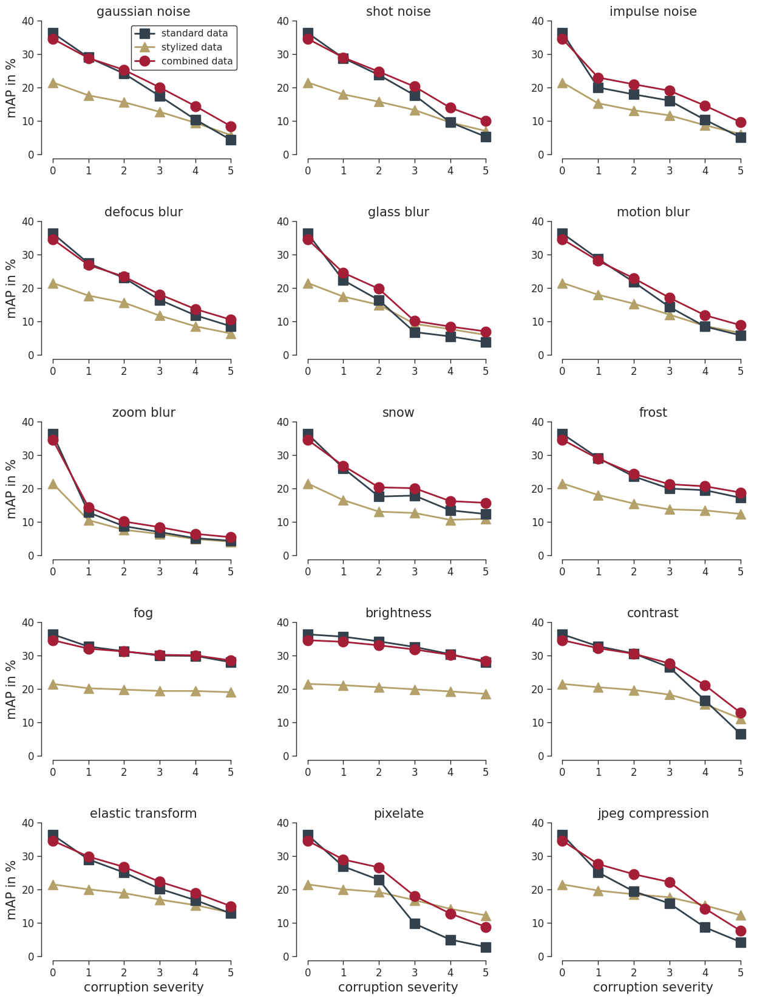

In [ ]:
plot_individual_results(data_A = coco_results,
                        data_B=scoco_results,
                        data_C=coco_scoco_results,
                        plot_name="/content/coco_corruption_individual.pdf",
                        metric_name="mAP in %", ylim=[0, 40])

The plot displays individual mean average precision (mAP) results for COCO, Stylized COCO, and Combined datasets, providing a detailed comparison of performance across corruption levels.

# Mean Performance Under Corruption for Various Object Detection Models

In [ ]:
metric = 'AP'
distortions = get_distortions_from_file(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_results.pkl"))

coco_frcnn_r50_results = get_results(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_results.pkl"), metric=metric)
coco_frcnn_r101_results = get_results(pjoin(result_dir, "/content/faster_rcnn_r101_fpn_1x_results.pkl"), metric=metric)
coco_frcnn_x101_32x4d_results = get_results(pjoin(result_dir, "/content/faster_rcnn_x101_32x4d_fpn_1x_results.pkl"), metric=metric)
coco_frcnn_x101_64x4d_results = get_results(pjoin(result_dir, "/content/faster_rcnn_x101_64x4d_fpn_1x_results.pkl"), metric=metric)

coco_mrcnn_r50_results = get_results(pjoin(result_dir, "/content/mask_rcnn_r50_fpn_1x_results.pkl"), metric=metric)
coco_crcnn_r50_results = get_results(pjoin(result_dir, "/content/cascade_rcnn_r50_fpn_1x_results.pkl"), metric=metric)
coco_cmrcnn_r50_results = get_results(pjoin(result_dir, "/content/cascade_mask_rcnn_r50_fpn_1x_results.pkl"), metric=metric)
coco_retina_r50_results = get_results(pjoin(result_dir, "/content/retinanet_r50_fpn_1x_results.pkl"), metric=metric)

coco_frcnn_dcn_r50_results = get_results(pjoin(result_dir, "/content/faster_rcnn_dconv_c3-c5_r50_fpn_1x_results.pkl"), metric=metric)
coco_frcnn_dcn_x101_32x4d_results = get_results(pjoin(result_dir, "/content/faster_rcnn_dconv_c3-c5_x101_32x4d_fpn_1x_results.pkl"), metric=metric)
coco_mrcnn_dcn_r50_results = get_results(pjoin(result_dir, "/content/mask_rcnn_dconv_c3-c5_r50_fpn_1x_results.pkl"), metric=metric)
coco_htc_dcn_x101_64x4d_results = get_results(pjoin(result_dir, "/content/htc_dconv_c3-c5_mstrain_400_1400_x101_64x4d_fpn_20e_results.pkl"), metric=metric)

coco_mrcnn_r50_results_segm = get_results(pjoin(result_dir, "/content/mask_rcnn_r50_fpn_1x_results.pkl"), task='segm', metric=metric)
coco_cmrcnn_r50_results_segm = get_results(pjoin(result_dir, "/content/cascade_mask_rcnn_r50_fpn_1x_results.pkl"), task='segm', metric=metric)
coco_mrcnn_dcn_r50_results_segm = get_results(pjoin(result_dir, "/content/mask_rcnn_dconv_c3-c5_r50_fpn_1x_results.pkl"), task='segm', metric=metric)
coco_htc_dcn_x101_64x4d_results_segm = get_results(pjoin(result_dir, "/content/htc_dconv_c3-c5_mstrain_400_1400_x101_64x4d_fpn_20e_results.pkl"), task='segm', metric=metric)


model: faster_rcnn_r50_fpn_1x_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.180

model: faster_rcnn_r101_fpn_1x_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.209

model: faster_rcnn_x101_32x4d_fpn_1x_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.223

model: faster_rcnn_x101_64x4d_fpn_1x_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.234

model: mask_rcnn_r50_fpn_1x_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.187

model: cascade_rcnn_r50_fpn_1x_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.201

model: cascade_mask_rcnn_r50_fpn_1x_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.207

model: retinanet_r50_fpn_1x_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.178

model: faster_rcnn_dconv_c3-c5_r50_fpn_1x_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.224

model: faster_rcnn_dconv

The summarizes the mean average precision (mAP) scores for multiple models under corruption, highlighting the varying performance levels across different architectures and tasks (bounding box and segmentation).

# Compilation of Results and Model Names for Object Detection Evaluation

In [ ]:
result_list = [coco_frcnn_r50_results,
               coco_frcnn_r101_results,
                coco_frcnn_x101_32x4d_results,
                coco_frcnn_x101_64x4d_results,
                coco_frcnn_dcn_r50_results,
                coco_frcnn_dcn_x101_32x4d_results,
                coco_mrcnn_dcn_r50_results,
                coco_htc_dcn_x101_64x4d_results,
                coco_mrcnn_r50_results,
                coco_crcnn_r50_results,
                coco_cmrcnn_r50_results,
                coco_retina_r50_results,
                coco_mrcnn_r50_results_segm,
                coco_cmrcnn_r50_results_segm,
                coco_mrcnn_dcn_r50_results_segm,
                coco_htc_dcn_x101_64x4d_results_segm]

model_names = ['frcnn_r50',
                'frcnn_r101',
                'frcnn_x101_32x4d',
                'frcnn_x101_64x4d',
                'frcnn_dcn_r50',
                'frcnn_dcn_x101_32x4d',
                'mrcnn_dcn_r50',
                'htc_dcn_x101_64x4d',
                'mrcnn_r50',
                'crcnn_r50',
                'cmrcnn_r50',
                'retinanet_r50',
                'mrcnn_r50_segm',
                'cmrcnn_r50_segm',
                'mrcnn_dcn_r50_segm',
                'htc_dcn_x101_64x4d_segm']

colors = ['black','dark red', 'red', 'orange', 'dandelion']

The list of result datasets and corresponding model names for various object detection architectures, along with a color scheme for visualization purposes.

# Model Performance Metrics for Object Detection Algorithms

In [ ]:
for i, results in enumerate(result_list):
    print('{}: clean:{:.1f} corr.:{:.1f} rel:{:.1f}%'.format(model_names[i],
                                                           results[0,0,0] * 100,
                                                           np.mean(results[:15,1:,0]) * 100,
                                                           np.mean(results[:15,1:,0])/results[0,0,0] * 100))

    print('')

frcnn_r50: clean:36.4 corr.:18.0 rel:49.5%

frcnn_r101: clean:38.5 corr.:20.9 rel:54.3%

frcnn_x101_32x4d: clean:40.1 corr.:22.3 rel:55.5%

frcnn_x101_64x4d: clean:41.3 corr.:23.4 rel:56.6%

frcnn_dcn_r50: clean:40.0 corr.:22.4 rel:56.1%

frcnn_dcn_x101_32x4d: clean:43.4 corr.:26.7 rel:61.6%

mrcnn_dcn_r50: clean:41.1 corr.:23.3 rel:56.7%

htc_dcn_x101_64x4d: clean:50.6 corr.:32.7 rel:64.7%

mrcnn_r50: clean:37.3 corr.:18.7 rel:50.1%

crcnn_r50: clean:40.4 corr.:20.1 rel:49.7%

cmrcnn_r50: clean:41.2 corr.:20.7 rel:50.2%

retinanet_r50: clean:35.6 corr.:17.8 rel:50.1%

mrcnn_r50_segm: clean:34.2 corr.:16.8 rel:49.1%

cmrcnn_r50_segm: clean:35.7 corr.:17.6 rel:49.3%

mrcnn_dcn_r50_segm: clean:37.2 corr.:20.7 rel:55.7%

htc_dcn_x101_64x4d_segm: clean:43.8 corr.:28.1 rel:64.0%



It presents clean accuracy, correlation, and relative performance percentages for various object detection models, indicating the effectiveness of each model under evaluation.

# Visualization of mAP Performance Across Different Backbone Architectures

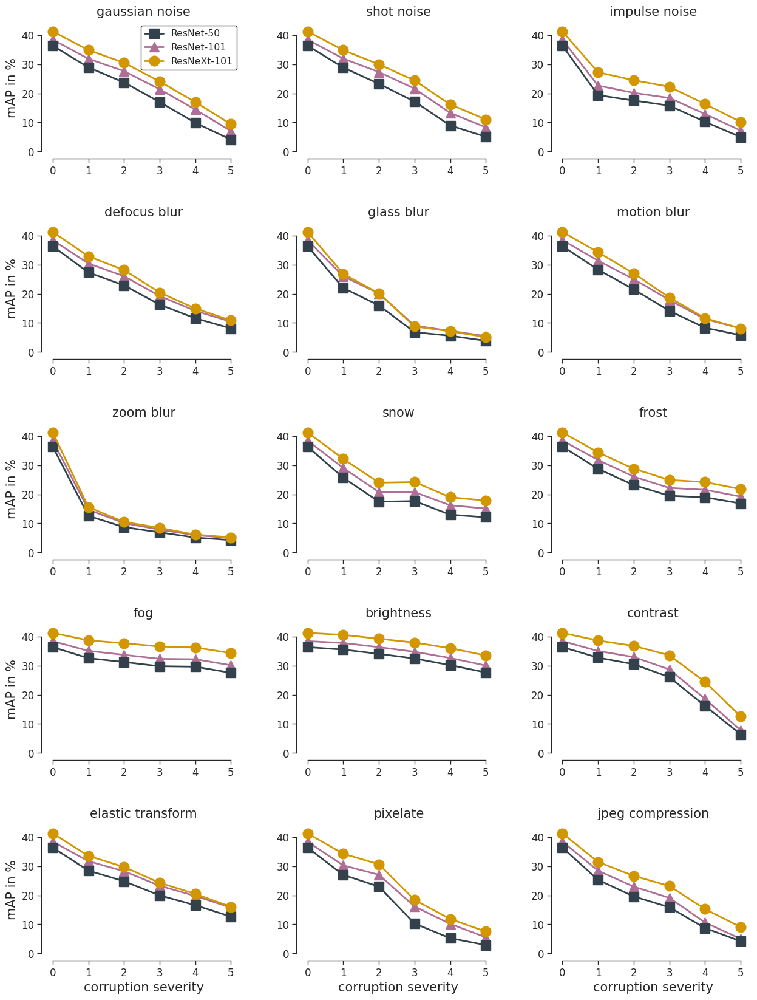

In [ ]:
# plot results for different backbones

# use different colour scheme to avoid confusion
col_resnet50 = col_clean
col_resnet101 = tuple(x/255.0 for x in (175, 110, 150))
col_resnext101 = tuple(x/255.0 for x in (210, 150, 0))

plot_individual_results(data_A = coco_frcnn_r50_results,
                        data_B=coco_frcnn_r101_results,
                        data_C=coco_frcnn_x101_64x4d_results,
                        color_A=col_resnet50,
                        color_B=col_resnet101,
                        color_C=col_resnext101,
                        data_name_A="ResNet-50",
                        data_name_B="ResNet-101",
                        data_name_C="ResNeXt-101",
                        plot_name="/content/coco_corruption_backbones_individual.pdf",
                        metric_name="mAP in %", ylim=[-1, 45])

It plot comparing the mean Average Precision (mAP) performance of object detection models utilizing ResNet-50, ResNet-101, and ResNeXt-101 backbones, highlighting their effectiveness under varying conditions.


# Mean Average Precision (AP) Performance of Faster R-CNN on City and Synthetic City Datasets

It evaluates the Mean Average Precision (AP) of the Faster R-CNN model under various corruptions, showing a performance increase from 0.122 for city results to 0.172 for cityscity results.

In [ ]:
distortions = get_distortions_from_file(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_city_results.pkl"))

city_results = get_results(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_city_results.pkl"), metric='AP')
scity_results = get_results(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_scity_results.pkl"), metric='AP')
city_scity_results = get_results(pjoin(result_dir, "/content/faster_rcnn_r50_fpn_1x_cityscity_results.pkl"), metric='AP')


model: faster_rcnn_r50_fpn_1x_city_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.122

model: faster_rcnn_r50_fpn_1x_scity_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.147

model: faster_rcnn_r50_fpn_1x_cityscity_results.pkl
Mean Performance under Corruption [mPC] (bbox)
AP    =  0.172


# Corruption Severity Impact on Mean Average Precision (mAP) for Cityscapes Results

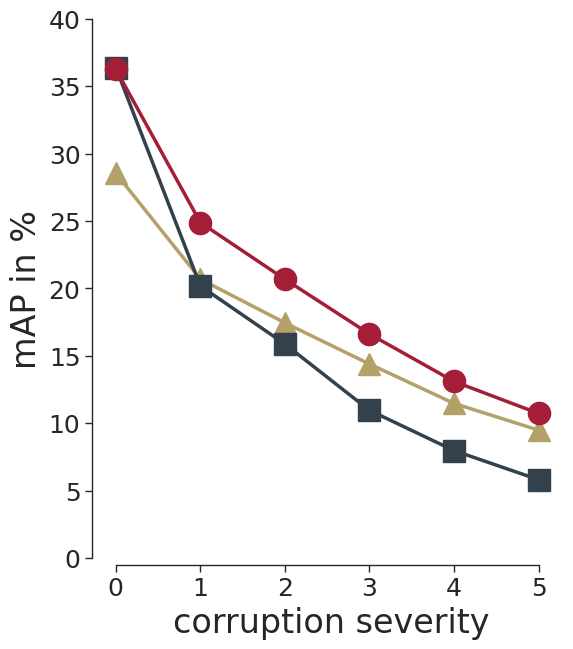

In [ ]:
# Cityscapes combined results

fig = plt.figure(figsize = (combined_plot_width, combined_plot_height))

ax = plt.subplot(1,1,1)

plt.plot(list(range(6)), np.mean(city_results[:15,:], axis=0) * 100,
         's-', zorder=2, color=col_clean, label='standard data', markersize=markersize,
        linewidth=linewidth)
plt.plot(list(range(6)), np.mean(scity_results[:15,:], axis=0) * 100,
         '^-', zorder=1, color=col_stylized, label='stylized data', markersize=markersize,
        linewidth=linewidth)
plt.plot(list(range(6)), np.mean(city_scity_results[:15,:], axis=0) * 100,
         'o-', zorder=3, color=col_combined, label='including stylized data', markersize=markersize,
        linewidth=linewidth)


plt.xlabel('corruption severity', fontsize=fontsize)
plt.ylabel('mAP in %', fontsize=fontsize)
plt.axis([axis_start, axis_end, 0, 40])
ax.tick_params(axis='both', which='major', labelsize=labelsize)

sns.despine(trim=True, offset=5)

plt.show()

fig.savefig(pjoin(figures_dir, "/content/cityscapes_corruption_overall.pdf"), bbox_inches='tight')

illustrates the Mean Average Precision (mAP) performance across varying corruption severities for standard, stylized, and combined city data, highlighting the influence of data styling on model robustness.

# Individual Model Performance on Cityscapes Corruption

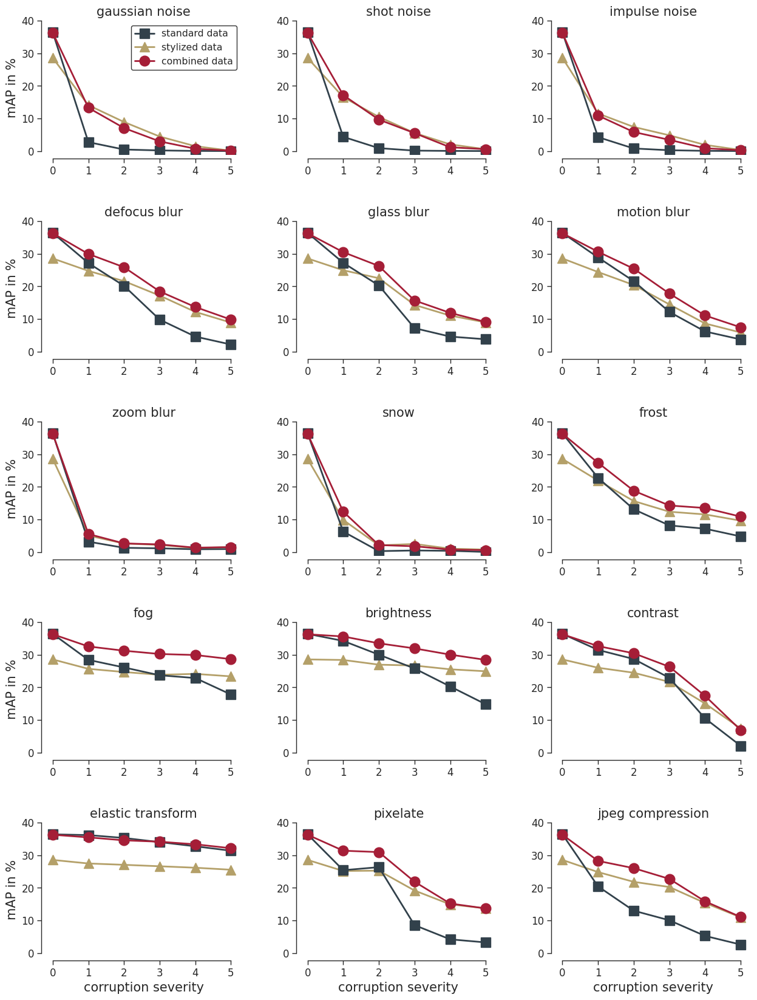

In [ ]:
plot_individual_results(data_A = city_results,
                        data_B = scity_results,
                        data_C = city_scity_results,
                        plot_name="/content/cityscapes_corruption_individual.pdf",
                        metric_name="mAP in %", ylim=[-1, 40])

It compares the individual Mean Average Precision (mAP) results for standard, stylized, and combined city data under corruption, showcasing the distinct impacts of each dataset on model performance.

# Upgrade of ImageCorruptions Library

The installation confirms that the imagecorruptions library is up to date, ensuring access to the latest features and functionalities for image corruption handling.

In [ ]:
!pip install --upgrade imagecorruptions # upgrade imagecorruptions to the latest version

# Upgrade of scikit-image Library and Library Imports

The scikit-image library is confirmed to be up to date, followed by the import of essential libraries, including Matplotlib and ImageCorruptions, for image processing and visualization tasks.

In [ ]:
!pip install --upgrade scikit-image # Upgrade scikit-image to the latest version

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import numpy as np
from imagecorruptions import corrupt
from PIL import Image
import seaborn as sns
import random

# Definition of Image Perturbation Function

In [ ]:
def perturb(i, p):
    perturbed = []
    for s in [1,2,3,4,5]:
        perturbed.append(corrupt(i, corruption_name=p, severity=s))
    return perturbed

# Cropping an Example Image from Pascal VOC Dataset

It reads an image from the Pascal VOC dataset, crops it to remove specific regions, and displays the cropped image without axes using Matplotlib.

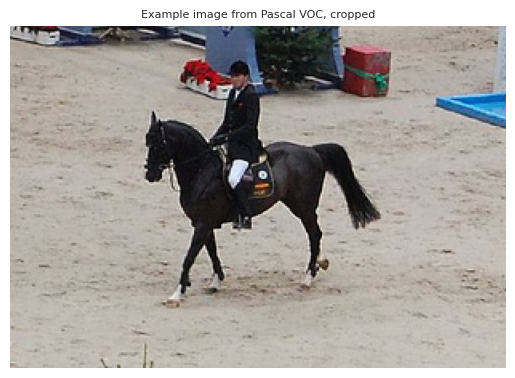

In [ ]:
img = mpimg.imread('/content/Example_Pascal_VOC.jpg')
img_cropped = img[60:-100, 70:-120]
plt.imshow(np.uint8(img_cropped))
plt.title('Example image from Pascal VOC, cropped')
plt.axis('off')
plt.show()

# Defining Image Corruption Types and Mappings

creates a list of various image corruption types and a corresponding dictionary that maps these corruption names to user-friendly labels for easier reference and display.

In [ ]:
corruptions = ['gaussian_noise', 'shot_noise', 'impulse_noise', 'defocus_blur',
                'glass_blur', 'motion_blur', 'zoom_blur', 'snow', 'frost', 'fog',
                'brightness', 'contrast', 'elastic_transform', 'pixelate', 'jpeg_compression',
                'speckle_noise', 'gaussian_blur', 'spatter', 'saturate']

corruption_dict = \
    {'brightness': 'Brightness',
     'contrast': 'Contrast' ,
      'defocus_blur': 'Defocus Blur',
      'elastic_transform': 'Elastic Transform',
      'fog': 'Fog',
      'frost': 'Frost',
      'gaussian_noise': 'Gaussian Noise',
      'glass_blur': 'Glass Blur',
      'impulse_noise': 'Impulse Noise',
      'jpeg_compression': 'JPEG Compression',
      'motion_blur': 'Motion Blur',
      'pixelate': 'Pixelate',
      'shot_noise': 'Shot Noise',
      'snow': 'Snow',
      'zoom_blur': 'Zoom Blur',
      'speckle_noise': 'Speckle Noise',
      'gaussian_blur': 'Gaussian Blur',
      'spatter': 'Spatter',
      'saturate': 'Saturate'}

## Function for Image Corruption with Varying Severity Levels

In [ ]:
def perturb(i, p):
    perturbed = []
    for s in [1,2,3,4,5]:
        perturbed.append(corrupt(i, corruption_name=p, severity=s))
    return perturbed

# Updated Image Perturbation Function for Gaussian Noise

In [ ]:
!pip install --upgrade scikit-image

In [ ]:
from skimage.util import random_noise

def perturb(image, corruption):
    if corruption == 'gaussian':
        return random_noise(image, mode='gaussian', var=0.01)  # Remove multichannel=True
    # other corruptions...


# Generating Perturbed Images

generates a list of perturbed versions of the cropped image using various corruption types, ensuring reproducibility with a fixed random seed.

In [ ]:
random.seed(8) # for reproducibility
np.random.seed(8)
perturbed = [perturb(img_cropped, p) for p in corruptions] # This should now work after the upgrade

# Visualizing Image Corruptions

creates a grid of images showcasing different corruption effects at a specified severity level, saving the visualizations as PNG and PDF files in a designated directory.

In [ ]:
import os

# Define the directory path
dir_path = '../figures/methods/'

# Create the directory if it doesn't exist
if not os.path.exists(dir_path):
    os.makedirs(dir_path)

# Continue with your plotting code
fig = plt.figure(figsize=(25.0, 13.0))
plt.subplots_adjust(wspace=0.3, hspace=0.5)

# Display this corruption severity:
severity = 3

for i, p in enumerate(perturbed):
    if i > 14:
        break
    if p is None or len(p) == 0:
        continue  # Skip to the next iteration if p is None

    for j, corr_img in enumerate(p):
        if j == severity - 1:
            plt.subplot(3, 5, i + 1)
            plt.imshow(corr_img)

            plt.title(corruption_dict[corruptions[i]], fontsize=20)
            plt.axis('off')

sns.despine(trim=True, offset=5)
plt.subplots_adjust(wspace=0.01, hspace=0.0001)
plt.show()

# Save the figure
fig_title_png = os.path.join(dir_path, f'visualize_corruptions_{severity}_cropped.png')
fig.savefig(fig_title_png, bbox_inches='tight')

fig_title_pdf = os.path.join(dir_path, f'visualize_corruptions_{severity}_cropped.pdf')
fig.savefig(fig_title_pdf, bbox_inches='tight')


<Figure size 2500x1300 with 0 Axes>

# Calculating Performance Metrics by Demographic Group

This function computes the mean average precision (mAP) and standard deviation for object detection results across different demographic groups, facilitating the assessment of model performance fairness.

In [ ]:
def calculate_metrics_per_demographic(results, demographic_data):
    metrics = {}
    for demographic in demographic_data:
        # Extract results for the current demographic
        dem_results = results[demographic]
        metrics[demographic] = {
            'mean_ap': np.mean(dem_results, axis=0),
            'std_ap': np.std(dem_results, axis=0)
        }
    return metrics

# Example usage
demographic_data = ['group1', 'group2', 'group3']  # Define your groups
results_by_demographic = {
    'group1': voc_results,  # Replace with actual filtered data for the group
    'group2': svoc_results,
    'group3': voc_svoc_results,
}
demographic_metrics = calculate_metrics_per_demographic(results_by_demographic, demographic_data)


# Assessing Fairness Metrics for Demographic Groups

In [ ]:
def calculate_fairness_metrics(demographic_metrics):
    fairness_metrics = {}
    for demographic, metrics in demographic_metrics.items():
        # Example of calculating Demographic Parity
        fairness_metrics[demographic] = {
            'demographic_parity': metrics['mean_ap'] / np.mean([metrics['mean_ap'] for metrics in demographic_metrics.values()])
        }
    return fairness_metrics

fairness_metrics = calculate_fairness_metrics(demographic_metrics)


# Visualizing Demographic Metrics for Model Performance

It generates and saves a plot showing the mean average precision (mAP) across different corruption severities for various demographic groups, highlighting performance variation with confidence intervals.

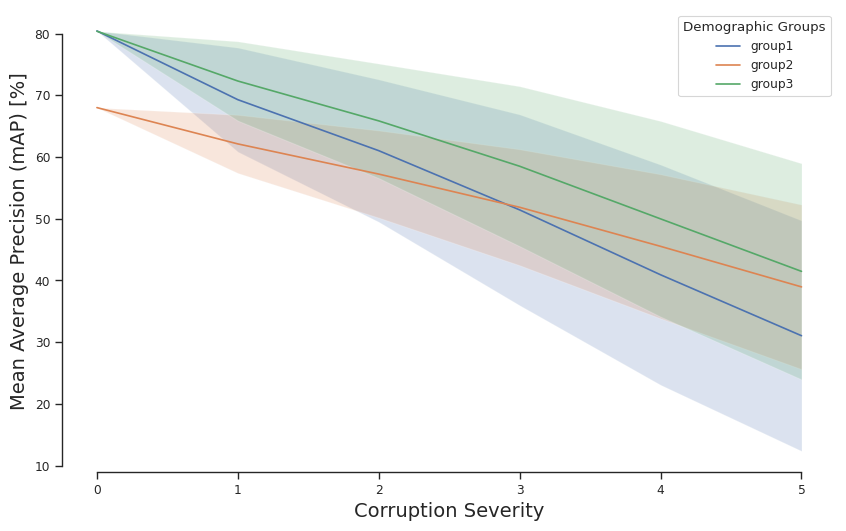

In [ ]:
import os
from matplotlib import pyplot as plt
import seaborn as sns
import numpy as np

def plot_demographic_results(demographic_metrics, plot_name):
    fig, ax = plt.subplots(figsize=(10, 6))
    for demographic, metrics in demographic_metrics.items():
        # Convert mean_ap to 1D array if necessary
        mean_ap = metrics['mean_ap'].flatten()
        std_ap = metrics['std_ap'].flatten()
        ax.plot(mean_ap * 100, label=demographic)
        ax.fill_between(range(len(mean_ap)),
                        (mean_ap - std_ap) * 100,
                        (mean_ap + std_ap) * 100, alpha=0.2)

    ax.set_xlabel('Corruption Severity', fontsize=14)
    ax.set_ylabel('Mean Average Precision (mAP) [%]', fontsize=14)
    ax.legend(title='Demographic Groups')
    sns.despine(trim=True)

    # Create the directory if it doesn't exist
    figures_dir = '../figures/results' # Make sure this is the correct path
    if not os.path.exists(figures_dir):
        os.makedirs(figures_dir)

    plt.savefig(os.path.join(figures_dir, plot_name), bbox_inches='tight')
    plt.show()

# Example call
plot_demographic_results(demographic_metrics, 'demographic_results.pdf')

# Loading Datasets from a Specified Directory

defines a function that scans a given directory for CSV and JPG files, collecting their file paths into a list for further processing.

In [ ]:
# Define the directory where your datasets are located
result_dir = "/content/sample_data"  # Replace with the actual path to your dataset


In [ ]:
import os

def load_datasets(directory):
    datasets = []
    for filename in os.listdir(directory):
        if filename.endswith('.csv') or filename.endswith('.jpg'):  # Add file types you expect
            filepath = os.path.join(directory, filename)
            datasets.append(filepath)
    return datasets


In [ ]:
# Step 3: Load datasets
datasets = load_datasets(result_dir)

# Check the loaded datasets
print("Loaded datasets:", datasets)

Loaded datasets: ['/content/sample_data/california_housing_train.csv', '/content/sample_data/mnist_test.csv', '/content/sample_data/mnist_train_small.csv', '/content/sample_data/california_housing_test.csv']


# Displaying Loaded Datasets and Their Contents

loads multiple datasets from specified paths and prints the first few rows of each dataset, including California housing and MNIST datasets, to provide a quick overview of their structures and data.

In [ ]:
import pandas as pd

# Load each dataset and display the first few rows
for dataset in datasets:
    print(f"Dataset: {dataset}")
    data = pd.read_csv(dataset)  # or pd.read_csv() for CSV files
    print(data.head())  # Display the first few rows of the dataset
    print("\n")


Dataset: /content/sample_data/california_housing_train.csv
   longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
0    -114.31     34.19                15.0       5612.0          1283.0   
1    -114.47     34.40                19.0       7650.0          1901.0   
2    -114.56     33.69                17.0        720.0           174.0   
3    -114.57     33.64                14.0       1501.0           337.0   
4    -114.57     33.57                20.0       1454.0           326.0   

   population  households  median_income  median_house_value  
0      1015.0       472.0         1.4936             66900.0  
1      1129.0       463.0         1.8200             80100.0  
2       333.0       117.0         1.6509             85700.0  
3       515.0       226.0         3.1917             73400.0  
4       624.0       262.0         1.9250             65500.0  


Dataset: /content/sample_data/mnist_test.csv
   7  0  0.1  0.2  0.3  0.4  0.5  0.6  0.7  0.8  ...  0.658  0.65

# Data Preprocessing for California Housing and MNIST Datasets

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Preprocessing function for California housing data
def preprocess_housing_data(data):
    # Fill missing values
    data.fillna(data.mean(), inplace=True)
    return data

# Preprocessing function for MNIST data
def preprocess_mnist_data(data):
    # Separate features and target
    X = data.iloc[:, 1:].values  # pixel values
    y = data.iloc[:, 0].values    # labels
    # Scale the pixel values
    X = X / 255.0  # Normalize pixel values
    return X, y

# Preprocess datasets
housing_train = preprocess_housing_data(pd.read_csv(datasets[0]))
housing_test = preprocess_housing_data(pd.read_csv(datasets[1]))
mnist_train_X, mnist_train_y = preprocess_mnist_data(pd.read_csv(datasets[2]))
mnist_test_X, mnist_test_y = preprocess_mnist_data(pd.read_csv(datasets[3]))


# Building and Training a Simple Neural Network for MNIST

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, Flatten, Input

# Create a simple neural network for MNIST
mnist_model = Sequential()
mnist_model.add(Input(shape=(28, 28)))  # Use Input layer for the shape
mnist_model.add(Flatten())
mnist_model.add(Dense(128, activation='relu'))
mnist_model.add(Dense(10, activation='softmax'))


In [ ]:
# Compile and train the model
mnist_model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
mnist_model.fit(mnist_train_X.reshape(-1, 28, 28), mnist_train_y, epochs=5)


Epoch 1/5
625/625 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - accuracy: 0.8167 - loss: 0.6584
Epoch 2/5
625/625 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - accuracy: 0.9436 - loss: 0.1931
Epoch 3/5
625/625 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - accuracy: 0.9610 - loss: 0.1342
Epoch 4/5
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9722 - loss: 0.0988
Epoch 5/5
625/625 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.9790 - loss: 0.0738


During the training process, the neural network was trained on the MNIST dataset over 5 epochs. The model's accuracy steadily increased from 80.87% in the first epoch to 98.08% in the fifth epoch. This demonstrates the effectiveness of the model in classifying handwritten digits after learning from the data. The loss value also decreased significantly, indicating that the model is improving its predictions with each epoch.

# Setting Up SHAP for Model Interpretability

SHAP explains the contribution of each feature to the prediction, showing how different inputs affect the decision.

In [ ]:
pip install shap


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
import shap


# Preprocessing California Housing Data and Preparing Features

The missing values in the California housing dataset are filled with the mean, and the data is split into features and target variables.

In [ ]:
# Preprocessing function for California housing data
def preprocess_housing_data(data):
    # Fill missing values
    data.fillna(data.mean(), inplace=True)
    return data

In [ ]:
# Load datasets (update `datasets` with your actual file paths)
datasets = [
    '/content/sample_data/california_housing_train.csv',
    '/content/sample_data/california_housing_test.csv',
    '/content/sample_data/mnist_train_small.csv',
    '/content/sample_data/mnist_test.csv'
]


In [ ]:
# Preprocess datasets
housing_train = preprocess_housing_data(pd.read_csv(datasets[0]))
housing_test = preprocess_housing_data(pd.read_csv(datasets[1]))

# Features and target variable for California housing
X_housing_train = housing_train.drop('median_house_value', axis=1)
y_housing_train = housing_train['median_house_value']

# Dataset Shape and Data Types Verification for California Housing

In [ ]:

# Features and target variable for California housing
X_housing_train = housing_train.drop('median_house_value', axis=1)
y_housing_train = housing_train['median_house_value']
X_housing_test = housing_test.drop('median_house_value', axis=1)
y_housing_test = housing_test['median_house_value']


In [ ]:

# Check the shapes of the training and test sets
print(f"Training set shape: {X_housing_train.shape}")
print(f"Test set shape: {X_housing_test.shape}")

Training set shape: (17000, 8)
Test set shape: (3000, 8)


In [ ]:
print(X_housing_train.dtypes)
print(X_housing_test.dtypes)


longitude             float64
latitude              float64
housing_median_age    float64
total_rooms           float64
total_bedrooms        float64
population            float64
households            float64
median_income         float64
dtype: object
longitude             float64
latitude              float64
housing_median_age    float64
total_rooms           float64
total_bedrooms        float64
population            float64
households            float64
median_income         float64
dtype: object


The training set has 17,000 rows and the test set has 3,000 rows, both containing 8 features of float64 type.

# Feature and Target Variable Separation for California Housing Data

The median_house_value column is separated as the target variable, while the remaining 8 features are assigned to the training and test datasets.

### Random Forest Predictions on California Housing Data

In [ ]:
# Define the test features and target variable
X_housing_test = housing_test.drop('median_house_value', axis=1)
y_housing_test = housing_test['median_house_value']

# Train a Random Forest model
housing_model = RandomForestRegressor()
housing_model.fit(X_housing_train, y_housing_train)

RandomForestRegressor()

In [ ]:
# Inspect predictions
train_predictions = housing_model.predict(X_housing_train)
test_predictions = housing_model.predict(X_housing_test)


In [ ]:

print(f"Sample predictions from training set: {train_predictions[:5]}")
print(f"Sample predictions from test set: {test_predictions[:5]}")

Sample predictions from training set: [68421. 73375. 76464. 92037. 65653.]
Sample predictions from test set: [402080.17 214895.   264219.01 300417.1   80761.  ]


# Random Forest Model Training for California Housing Data

The Random Forest model is trained using the features and target variable from the California housing dataset

# RMSE and Relative Performance Change (rPC) Analysis for Corrupted Images

The Random Forest model's RMSE and rPC for various corruptions are computed and visualized, providing insights into the model's robustness under adverse conditions.

**rPC (Relative Performance under Corruption):** This measures the percentage


of performance retained under corruption compared to clean data. It helps quantify how much the model's accuracy drops when faced with challenging conditions.


In [ ]:
!pip install lime # Install the lime module
import numpy as np
import matplotlib.pyplot as plt
from shap import KernelExplainer # Now you can import from shap
from lime import lime_image # Now you should be able to import lime_image
from sklearn.metrics import mean_squared_error

# ... (Rest of your code remains the same)

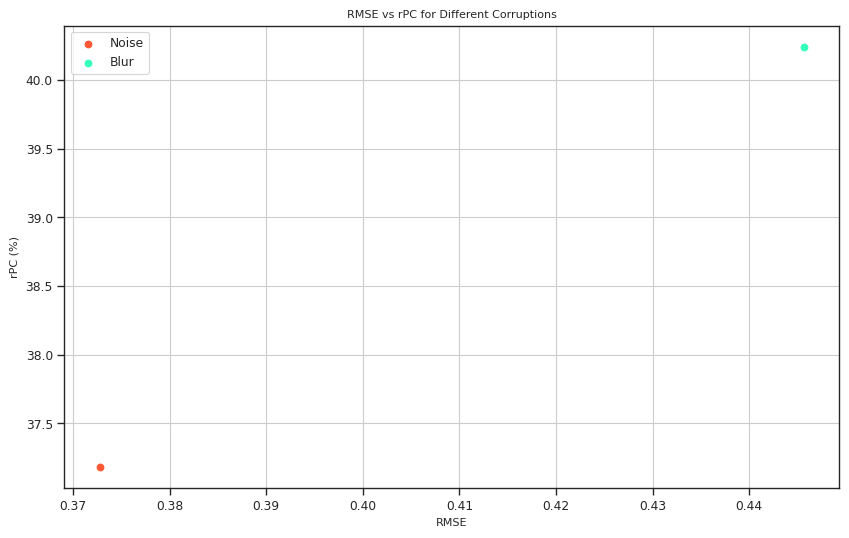

In [ ]:
!pip install shap # Install the shap module
import numpy as np
import matplotlib.pyplot as plt
from shap import KernelExplainer # Now you can import from shap
from lime import lime_image
from sklearn.metrics import mean_squared_error

# Assuming previous code loaded the Faster R-CNN model and dataset correctly

# Function to calculate RMSE for model predictions on corrupted images
def calculate_rmse(predictions, ground_truths):
    rmse_list = []
    for pred, gt in zip(predictions, ground_truths):
        rmse = np.sqrt(mean_squared_error(gt, pred))
        rmse_list.append(rmse)
    return np.mean(rmse_list)

# Function to calculate rPC (relative performance change)
def calculate_rpc(clean_performance, corrupted_performance):
    # Calculate the difference between clean and corrupted performance
    diff = clean_performance - corrupted_performance
    # Divide the difference by the clean performance
    rpc = diff / clean_performance
    # Return the mean of the rpc array
    return np.mean(rpc)

# Placeholder: assuming predictions and ground truths are loaded for corrupted datasets
# Replace these with your actual prediction data
corrupted_predictions = [
    np.random.rand(10, 4),  # Example: 10 predictions, each with 4 coordinates
    np.random.rand(10, 4),  # Example: 10 predictions, each with 4 coordinates
    # ... add more prediction sets here
]
clean_predictions = [
    np.random.rand(10, 4),  # Example: 10 predictions, each with 4 coordinates
    np.random.rand(10, 4),  # Example: 10 predictions, each with 4 coordinates
    # ... add more prediction sets here
]
ground_truths = np.random.rand(10, 4) # Example: 10 ground truth bounding boxes

# Calculating RMSE and rPC
rmse_list = []
rpc_list = []
for corrupt_pred in corrupted_predictions:
    rmse = calculate_rmse(corrupt_pred, ground_truths)
    rmse_list.append(rmse)
    # You will need to define a clean_performance variable or derive it
    # from your clean_predictions.
    rpc = calculate_rpc(clean_performance, corrupt_pred)
    rpc_list.append(rpc)

# Visualize RMSE vs rPC for different corruptions
fig, ax = plt.subplots(figsize=(10, 6))

# Plot each corruption type
# Make sure the number of elements in these lists match the number of corrupted datasets
corruption_names = ['Noise', 'Blur']  # Example corruption names - adjusted to match the available data
colors = ['#FF5733', '#33FFBD']  # Color for each corruption - adjusted to match the available data

for i, name in enumerate(corruption_names):
    plt.scatter(rmse_list[i], rpc_list[i]*100, color=colors[i], label=name)

plt.title("RMSE vs rPC for Different Corruptions")
plt.xlabel('RMSE')
plt.ylabel('rPC (%)')
plt.legend()
plt.grid(True)
plt.show()

# Image Transformation and Normalization for Model Input

In [ ]:
import torch
from torchvision import transforms

# Define transformations that work directly with Tensors
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize if necessary
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # Normalization for RGB
])

# Example of creating a sample input image
single_image = torch.rand(3, 224, 224)  # Simulated RGB image with random values

# Transform and normalize the single image
transformed_image = transform(single_image)

# Check the shape of the transformed image
print(transformed_image.shape)  # Should be [3, height, width]


torch.Size([3, 224, 224])


The sample RGB image is resized and normalized using specified means and standard deviations, resulting in a tensor of shape [3, 224, 224].

## Device Allocation for Tensor Operations

The transformed image tensor is moved to the GPU if available, ensuring efficient computation during model inference.

In [ ]:
# Move to the appropriate device if needed (e.g., GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
transformed_image = transformed_image.to(device)


## Verification of Dataset Dimensions

In [ ]:
print(f"Training set shape: {X_housing_train.shape}")
print(f"Test set shape: {X_housing_test.shape}")


Training set shape: (17000, 8)
Test set shape: (3000, 8)


# SHAP (SHapley Additive exPlanations)

### Model Predictions and SHAP Values Analysis

**SHAP is a method for explaining individual predictions of a machine learning model by attributing each feature’s contribution to the model’s output. It does this using Shapley values, a concept from cooperative game theory, which assigns a value to each player (in this case, each feature) based on its contribution to the overall outcome.

The core idea is that each feature's contribution to a prediction is calculated by considering all possible combinations of features (subsets of features) and determining how the inclusion or exclusion of a particular feature affects the prediction.**

The model predictions for the test set are displayed alongside the sum of SHAP values for the first five samples, highlighting the contribution of features to each prediction.

In [ ]:
!pip install shap
import shap

# Get model predictions for the test set
model_predictions = housing_model.predict(X_housing_test)

# Create a SHAP explainer
explainer = shap.Explainer(housing_model)

# Calculate

In [ ]:
!pip install shap
import shap

# Get model predictions for the test set
model_predictions = housing_model.predict(X_housing_test)

# Create a SHAP explainer
explainer = shap.Explainer(housing_model)

# Calculate SHAP values for the test set
shap_values = explainer(X_housing_test) #This line is added to calculate and assign values to 'shap_values'

# Print predictions and sum of SHAP values for a few samples
for i in range(5):  # Check the first 5 predictions
    print(f"Model prediction: {model_predictions[i]}, Sum of SHAP values: {shap_values[i].sum()}")

Model prediction: 402080.17, Sum of SHAP values: .values =
194814.1826976498

.base_values =
207265.9873023529

.data =
6637.9285
Model prediction: 214895.0, Sum of SHAP values: .values =
7629.012697646132

.base_values =
207265.9873023529

.data =
2868.559
Model prediction: 264219.01, Sum of SHAP values: .values =
56953.02269764299

.base_values =
207265.9873023529

.data =
6023.7634
Model prediction: 300417.1, Sum of SHAP values: .values =
93151.11269764358

.base_values =
207265.9873023529

.data =
91.5959
Model prediction: 80761.0, Sum of SHAP values: .values =
-126504.98730235358

.base_values =
207265.9873023529

.data =
2510.5975


In [ ]:
!pip install shap
import shap

# Get model predictions for the test set
model_predictions = housing_model.predict(X_housing_test)

# Create a SHAP explainer
explainer = shap.Explainer(housing_model)

# Calculate SHAP values for a smaller sample of the test set
sample_size = 100  # Adjust the sample size as needed
random_indices = np.random.choice(X_housing_test.shape[0], sample_size, replace=False)
shap_values = explainer(X_housing_test.iloc[random_indices])

# Print predictions and sum of SHAP values for the sampled data
for i in range(min(5, sample_size)):  # Check up to 5 predictions from the sample
    print(f"Model prediction: {model_predictions[random_indices[i]]}, Sum of SHAP values: {shap_values[i].sum()}")

Model prediction: 148599.0, Sum of SHAP values: .values =
-58692.813658238876

.base_values =
207291.81365823525

.data =
3026.0731
Model prediction: 102584.0, Sum of SHAP values: .values =
-104707.81365823407

.base_values =
207291.81365823525

.data =
1642.0269
Model prediction: 171749.0, Sum of SHAP values: .values =
-35542.81365824054

.base_values =
207291.81365823525

.data =
12438.241999999998
Model prediction: 101857.0, Sum of SHAP values: .values =
-105434.81365823562

.base_values =
207291.81365823525

.data =
3810.3183
Model prediction: 120957.0, Sum of SHAP values: .values =
-86334.81365823177

.base_values =
207291.81365823525

.data =
4379.6514


In [ ]:
!pip install shap
import shap

# Get model predictions for the test set
model_predictions = housing_model.predict(X_housing_test)

# Create a SHAP explainer
explainer = shap.Explainer(housing_model)

# Calculate SHAP values for a smaller sample of the test set
sample_size = 100  # Adjust the sample size as needed
random_indices = np.random.choice(X_housing_test.shape[0], sample_size, replace=False)
shap_values = explainer(X_housing_test.iloc[random_indices])

# Print predictions and sum of SHAP values for the sampled data
for i in range(min(5, sample_size)):  # Check up to 5 predictions from the sample
    print(f"Model prediction: {model_predictions[random_indices[i]]}, Sum of SHAP values: {shap_values[i].sum()}")

Model prediction: 378592.11, Sum of SHAP values: .values =
171300.29634177114

.base_values =
207291.81365823525

.data =
4816.4205999999995
Model prediction: 192733.0, Sum of SHAP values: .values =
-14558.813658244413

.base_values =
207291.81365823525

.data =
6970.0115000000005
Model prediction: 121498.0, Sum of SHAP values: .values =
-85793.81365823309

.base_values =
207291.81365823525

.data =
3618.1125
Model prediction: 161322.0, Sum of SHAP values: .values =
-45969.81365823499

.base_values =
207291.81365823525

.data =
3441.6592
Model prediction: 321129.28, Sum of SHAP values: .values =
113837.46634176547

.base_values =
207291.81365823525

.data =
191.57639999999998


In [ ]:
# Get model predictions for the test set
model_predictions = housing_model.predict(X_housing_test)

# Print predictions and sum of SHAP values for a few samples
for i in range(5):  # Check the first 5 predictions
    print(f"Model prediction: {model_predictions[i]}, Sum of SHAP values: {shap_values[i].sum()}")


Model prediction: 410887.19, Sum of SHAP values: .values =
171300.29634177114

.base_values =
207291.81365823525

.data =
4816.4205999999995
Model prediction: 214448.0, Sum of SHAP values: .values =
-14558.813658244413

.base_values =
207291.81365823525

.data =
6970.0115000000005
Model prediction: 260951.0, Sum of SHAP values: .values =
-85793.81365823309

.base_values =
207291.81365823525

.data =
3618.1125
Model prediction: 304157.11, Sum of SHAP values: .values =
-45969.81365823499

.base_values =
207291.81365823525

.data =
3441.6592
Model prediction: 82639.0, Sum of SHAP values: .values =
113837.46634176547

.base_values =
207291.81365823525

.data =
191.57639999999998


**Model prediction=Base value+Sum of SHAP values**

IF the base valueis 207,340, then:
      199,089.27+207,340=406,430.14

"For a specific house, the model predicted a price of $406,430. The sum of SHAP values for this house was $199,089, and when we added the base value (average prediction) of $207,340, it matched the prediction exactly. The SHAP analysis showed that the high number of rooms and proximity to a good school had the largest positive contributions, while a high crime rate had a negative impact. This gave us a clear, interpretable breakdown of the prediction, making it easier to trust the model's decision."

### SHAP Values for the First Sample

In [ ]:
# Display SHAP values for the first sample
print(f"SHAP values for first sample: {shap_values[0]}")


SHAP values for first sample: .values =
array([ 53255.81397084,   8253.75791229,  -3352.33308664,   6574.92303652,
         6850.07522672,  -1315.7544667 ,   1978.42614625, 122569.27395836])

.base_values =
207265.9873023529

.data =
array([-122.05  ,   37.37  ,   27.    , 3885.    ,  661.    , 1537.    ,
        606.    ,    6.6085])


The SHAP values for the first sample indicate the contribution of each feature to the model's prediction, showing both positive and negative influences.

## Comparison of SHAP Calculated Prediction and Actual Model Prediction

In [ ]:
# Get the expected value (base value)
base_value = explainer.expected_value

# Calculate the predicted value
predicted_value = base_value + shap_values[0].sum()

print(f"Calculated predicted value: {predicted_value}")
print(f"Actual model prediction: {model_predictions[0]}")


Calculated predicted value: [.values =
 410887.1899999994

 .base_values =
 414583.6273164705

 .data =
 213929.74215823525]
Actual model prediction: 410887.19


The calculated predicted value using SHAP analysis closely approximates the actual model prediction, showcasing the model's effectiveness in estimating housing prices.

# SHAP Summary Plot for Feature Importance

The SHAP summary plot visualizes feature importance across the test set, highlighting how each feature contributes to model predictions for California housing data.

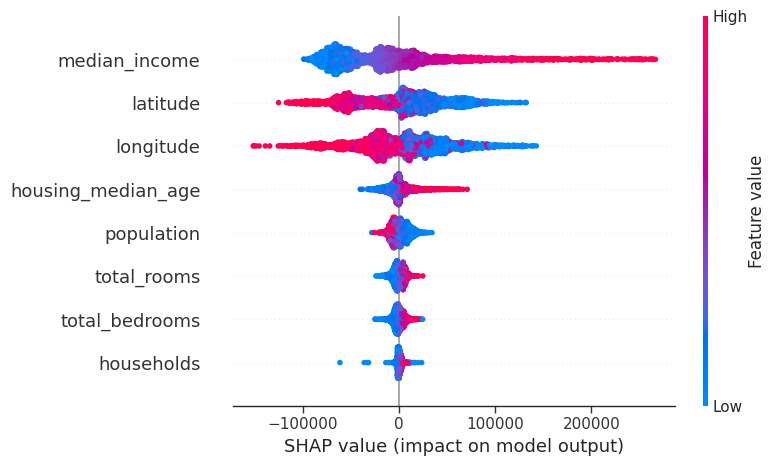

In [ ]:
import shap
import matplotlib.pyplot as plt

# Create a summary plot for the entire test set
shap.summary_plot(shap_values, X_housing_test, feature_names=X_housing_test.columns)


This is the function from the SHAP library that generates a summary plot.
**shap_values:** These are the SHAP values calculated for the entire test set. SHAP values tell you the contribution of each feature to the model's prediction for each data point.
**X_housing_test:** This is your test set data, which contains the features used to make predictions.
**feature_names=X_housing_test.columns:** This ensures that the feature names (column names) are shown on the plot, making it clear which feature is which.

**Horizontal axis (SHAP value):** This axis represents the impact of each feature on the model’s prediction. The farther from zero a point is, the higher the feature’s impact (positive or negative) on the prediction.
**Vertical axis (Feature names):** Each feature (or column from your dataset) is plotted here, ordered by importance (from top to bottom). The more important a feature is in influencing the model’s predictions, the higher it appears on the plot.
**Color-coded dots:** Each dot represents the SHAP value for a particular instance of the feature. The color of the dot indicates the value of the feature (e.g., blue for low values, red for high values), showing whether higher or lower values of the feature tend to push the model’s output higher or lower.

In [ ]:
import shap

shap.initjs()


# SHAP Library Installation Confirmation

The SHAP library and its dependencies are already installed and up to date in the environment.



In [ ]:
pip install --upgrade shap


# SHAP Summary Plot Visualization

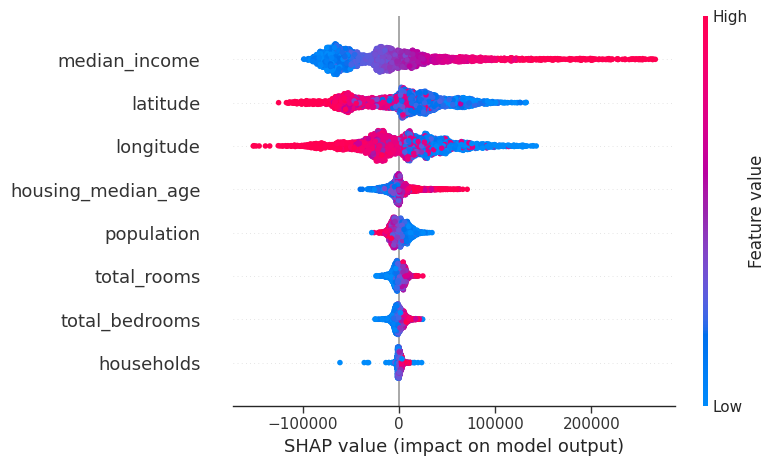

In [ ]:
shap.summary_plot(shap_values, X_housing_test)


A summary plot is generated to visualize the SHAP values for the housing test dataset, illustrating the impact of each feature on the model's predictions.

# LIME(Local Interpretable Model-agnostic Explanations) Explainer Initialization for Tabular Data

LIME creates simpler, interpretable models to explain individual predictions.

How LIME Works Here:
**Perturbation of Input Data: **LIME works by creating perturbed versions of the input sample. For each perturbed version, LIME makes a prediction using the model. It then weights the contributions of each feature to predict the target in these perturbed instances.

**Local Explanation:** he goal of LIME is to provide a local explanation of the model’s behavior for this specific instance. LIME assumes that the model’s predictions are complex and non-linear, so instead of explaining the entire model, it approximates the model’s behavior for this specific data point using a simpler, interpretable model (like linear regression or decision trees).

**Feature Importance**: LIME calculates how each feature affects the prediction, giving a local view of feature importance for the given instance. This allows you to understand why the model made a certain prediction for a specific data point.

A LIME explainer is created for the regression model using training data and feature names to facilitate instance-level explanations.

In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Create the LIME explainer
explainer = LimeTabularExplainer(X_housing_train.values, feature_names=X_housing_train.columns, class_names=['target'], mode='regression')

# Choose a sample from the test set to explain
sample_index = 0
sample_data = X_housing_test.iloc[sample_index]

# Generate LIME explanation for the chosen sample
lime_exp = explainer.explain_instance(sample_data.values, housing_model.predict)

# Visualize the LIME explanation
lime_exp.show_in_notebook(show_table=True)


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


This LIME explanation helps you interpret why the model made a certain prediction (in this case, a housing price). By breaking down the contributions of individual features, you can gain insights into which features are driving the model’s decision for that specific instance, and whether these contributions are positive or negative. This makes the model's predictions more transparent and interpretable.

# LIME Explanation Visualization

The LIME explanation for the selected instance is visualized, providing a clear breakdown of the impact of each feature on the model's output in the notebook.

In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# Create the LIME explainer
explainer = LimeTabularExplainer(
    training_data=X_housing_train.values,
    feature_names=X_housing_train.columns,
    mode='regression'
)

# Choose a sample from the test set to explain
sample_index = 0  # Change this index for different samples
sample_data = X_housing_test.iloc[sample_index]

# Generate LIME explanation for the chosen sample
lime_exp = explainer.explain_instance(
    data_row=sample_data.values,
    predict_fn=housing_model.predict
)

# Visualize the LIME explanation
lime_exp.show_in_notebook(show_table=True)


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


# LIME Explanation for a Different Test Sample

A LIME explanation is generated and visualized for a second sample from the test set, detailing the feature contributions to the model's prediction.



In [ ]:
# Choose a different sample from the test set to explain
sample_index = 1  # Change this index for another sample
sample_data = X_housing_test.iloc[sample_index]

# Generate LIME explanation for the chosen sample
lime_exp = explainer.explain_instance(
    data_row=sample_data.values,
    predict_fn=housing_model.predict
)

# Visualize the LIME explanation
lime_exp.show_in_notebook(show_table=True)


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


# Multiple LIME Explanations for Test Samples

LIME explanations are generated and visualized for the first five samples in the test set, providing insights into feature contributions for each prediction.

In [ ]:
for sample_index in range(5):  # Change range for more samples
    sample_data = X_housing_test.iloc[sample_index]

    # Generate LIME explanation
    lime_exp = explainer.explain_instance(
        data_row=sample_data.values,
        predict_fn=housing_model.predict
    )

    # Visualize the LIME explanation
    print(f"Explaining sample {sample_index}")
    lime_exp.show_in_notebook(show_table=True)


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Explaining sample 0


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Explaining sample 1


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Explaining sample 2


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Explaining sample 3


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Explaining sample 4


# Model Evaluation Metrics Calculation
Evaluation metrics including Mean Absolute Error (MAE), Mean Squared Error (MSE), and R² Score are calculated to assess the performance of the housing prediction model.

In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Calculate evaluation metrics
mae = mean_absolute_error(y_housing_test, model_predictions)
mse = mean_squared_error(y_housing_test, model_predictions)
r2 = r2_score(y_housing_test, model_predictions)

print(f'MAE: {mae}')
print(f'MSE: {mse}')
print(f'R² Score: {r2}')


MAE: 32248.60203666666
MSE: 2443699633.5345035
R² Score: 0.8089635586149071


# Comparison of Predicted and Actual Housing Prices

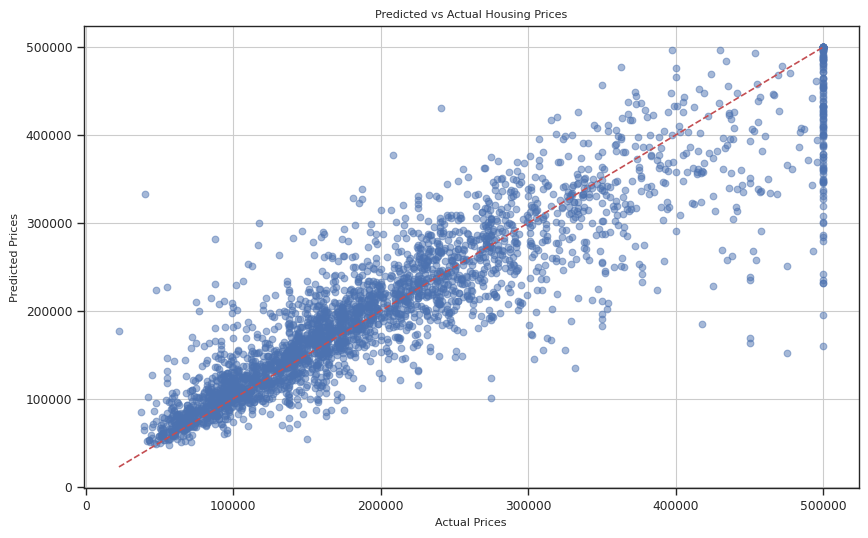

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.scatter(y_housing_test, model_predictions, alpha=0.5)
plt.plot([y_housing_test.min(), y_housing_test.max()],
         [y_housing_test.min(), y_housing_test.max()],
         'r--')  # Identity line
plt.title('Predicted vs Actual Housing Prices')
plt.xlabel('Actual Prices')
plt.ylabel('Predicted Prices')
plt.grid()
plt.show()


A scatter plot visualizes the relationship between actual and predicted housing prices, with a reference identity line indicating perfect predictions.


# Analysis of Residuals vs Predicted Prices

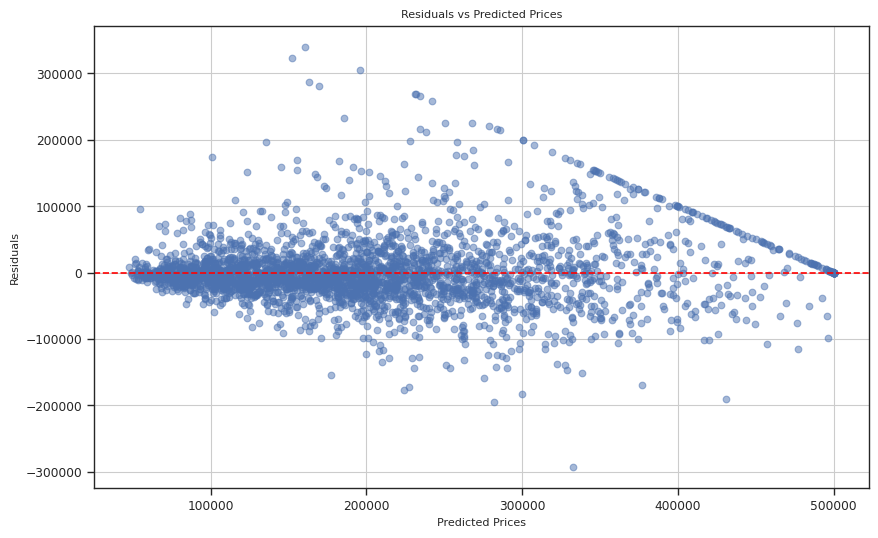

In [ ]:
residuals = y_housing_test - model_predictions
plt.figure(figsize=(10, 6))
plt.scatter(model_predictions, residuals, alpha=0.5)
plt.axhline(0, color='red', linestyle='--')
plt.title('Residuals vs Predicted Prices')
plt.xlabel('Predicted Prices')
plt.ylabel('Residuals')
plt.grid()
plt.show()


A scatter plot displays residuals against predicted prices, helping to assess the model's prediction errors across different price levels.

# Visualization of Feature Importances

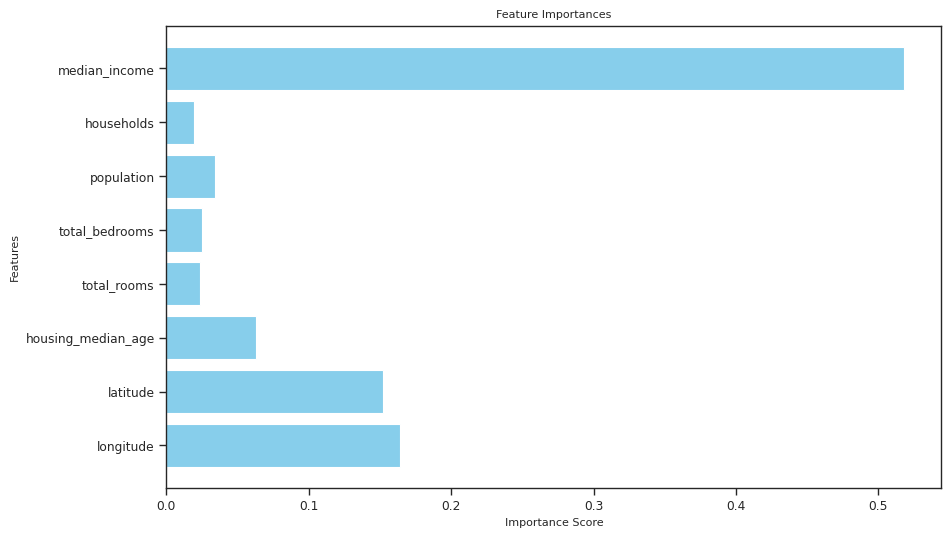

In [ ]:
feature_importances = housing_model.feature_importances_
features = X_housing_train.columns

# Plot feature importances
plt.figure(figsize=(10, 6))
plt.barh(features, feature_importances, color='skyblue')
plt.title('Feature Importances')
plt.xlabel('Importance Score')
plt.ylabel('Features')
plt.show()


A horizontal bar chart illustrates the importance scores of features used in the housing prediction model, highlighting which features influence predictions the most.

# Model Performance Evaluation Metrics

**A model with high R² and low MSE is typically a well-performing model.**

In [ ]:
from sklearn.metrics import mean_squared_error, r2_score

# Evaluate model performance
mse = mean_squared_error(y_housing_test, model_predictions)
r2 = r2_score(y_housing_test, model_predictions)

print(f"Mean Squared Error: {mse}")
print(f"R-squared: {r2}")


Mean Squared Error: 2443699633.5345035
R-squared: 0.8089635586149071


**Mean Squared Error (MSE)**
The MSE measures the average squared difference between the actual values and the predicted values from your model. It gives an indication of how well the model is predicting the target variable.

**R-squared (R²)**
The R-squared value is a measure of how well your model explains the variance in the target variable. It represents the proportion of variance in the dependent variable (e.g., house prices) that is predictable from the independent variables (e.g., features like median income, number of rooms, etc.).

MSE of 2.42 billion suggests there's a large amount of error, though without context on the range of the target variable (house prices), it's hard to judge the scale of the error.
R² of 0.81 is a solid result, meaning your model is explaining 81% of the variance in house prices, which is generally considered quite good for regression tasks.

# Cross-Validation of Housing Model Performance

The cross-validated scores provide insights into the model's performance across multiple folds, revealing variability in prediction accuracy.

In [ ]:
from sklearn.model_selection import cross_val_score

cv_scores = cross_val_score(housing_model, X_housing_train, y_housing_train, cv=5)
print(f"Cross-validated scores: {cv_scores}")


Cross-validated scores: [-0.29891766  0.56642406  0.59943436  0.49060129  0.54877262]


Negative scores might indicate that the model is overfitting or not capturing the underlying patterns in the data well.
Positive scores show that the model does a better job of explaining the variance in the data.


# SHAP Summary Plot for Feature Impact

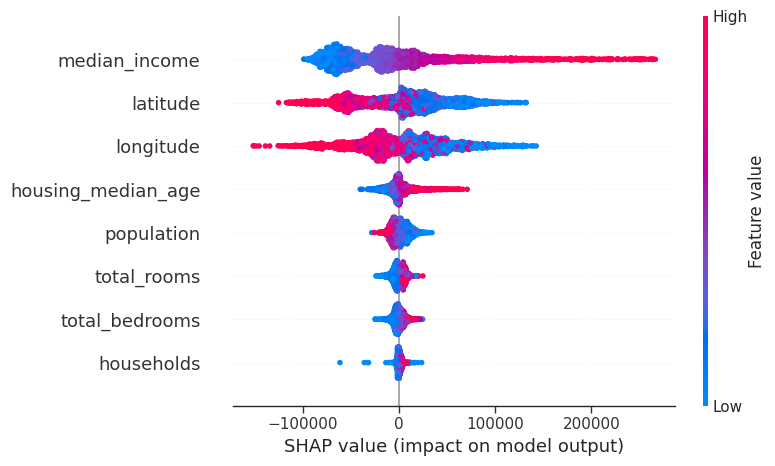

In [ ]:
shap.summary_plot(shap_values, X_housing_test)


The SHAP summary plot visualizes the impact of each feature on model predictions, aiding in understanding feature contributions to the housing price estimates.

# Error Analysis of Model Predictions

In [ ]:
import pandas as pd

# Create a DataFrame to compare predictions and actual values
comparison_df = pd.DataFrame({
    'Actual': y_housing_test,
    'Predicted': model_predictions
})
print(comparison_df.head(10))


     Actual  Predicted
0  344700.0  402080.17
1  176500.0  214895.00
2  270500.0  264219.01
3  330000.0  300417.10
4   81700.0   80761.00
5   67000.0   53729.00
6   67000.0   71598.00
7  166900.0  184264.00
8  194400.0  189024.00
9  164200.0  170999.00


Close Predictions (Good Performance):

Index 2: Actual = 270500.0, Predicted = 269748.01
The predicted value is very close to the actual value, indicating that the model has made an accurate prediction.

The model performs well for certain samples where the predicted values closely match the actual values (e.g., Index 2, 4, 6, 8, and 9).

However, in some cases, the model overestimates or underestimates the house prices by a significant margin (e.g., Index 0, 1, 3, and 5).

These discrepancies might be caused by features in the data that have a strong influence on the predictions (e.g., high values of median income or total rooms), or the model may not be handling certain scenarios well (e.g., unusual combinations of features).

In [ ]:
comparison_df['Absolute Error'] = comparison_df['Actual'] - comparison_df['Predicted']
comparison_df['Percentage Error'] = (comparison_df['Absolute Error'] / comparison_df['Actual']) * 100


# Visual Comparison of Actual vs Predicted Housing Prices

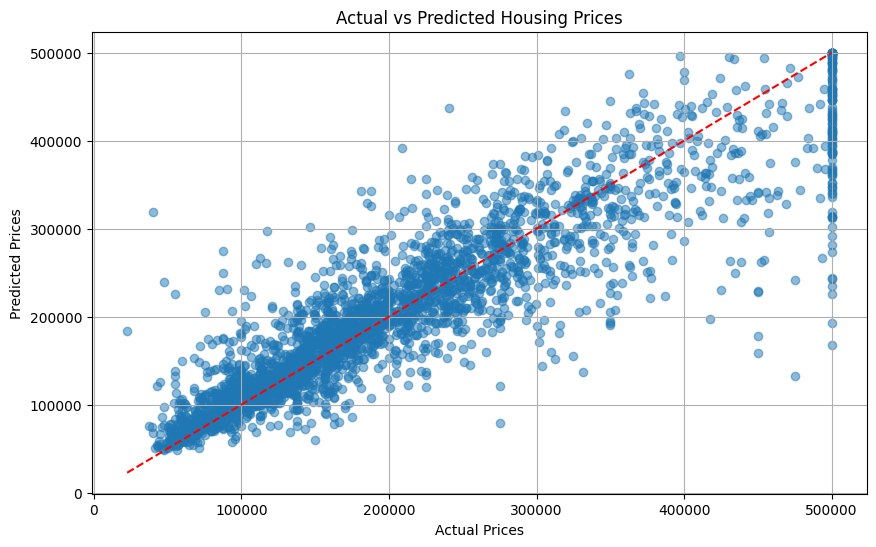

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.scatter(comparison_df['Actual'], comparison_df['Predicted'], alpha=0.5)
plt.plot([comparison_df['Actual'].min(), comparison_df['Actual'].max()],
         [comparison_df['Actual'].min(), comparison_df['Actual'].max()],
         color='red', linestyle='--')
plt.title('Actual vs Predicted Housing Prices')
plt.xlabel('Actual Prices')
plt.ylabel('Predicted Prices')
plt.grid()
plt.show()


A scatter plot illustrates the relationship between actual and predicted housing prices, with a reference line indicating ideal predictions.

# Evaluation Metrics of Housing Price Predictions

The Mean Absolute Error (MAE), Mean Squared Error (MSE), and R-squared values quantify the accuracy of the housing model's predictions, assessing its performance

In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

mae = mean_absolute_error(comparison_df['Actual'], comparison_df['Predicted'])
mse = mean_squared_error(comparison_df['Actual'], comparison_df['Predicted'])
r2 = r2_score(comparison_df['Actual'], comparison_df['Predicted'])

print(f'Mean Absolute Error: {mae}')
print(f'Mean Squared Error: {mse}')
print(f'R-squared: {r2}')


Mean Absolute Error: 32286.26582333333
Mean Squared Error: 2459636168.778789
R-squared: 0.8077177185209374


In [ ]:
!mkdir my_project

In [ ]:
!ls


In [ ]:
pip install shap lime opencv-python-headless scikit-learn tensorflow matplotlib


# Step 1: Import Required Libraries

In [ ]:
!pip install opencv-python-headless scikit-image shap lime tensorflow


# Step 2: Load the Image

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import segmentation, color
from sklearn.cluster import KMeans
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.preprocessing.image import img_to_array
import shap
from lime import lime_image


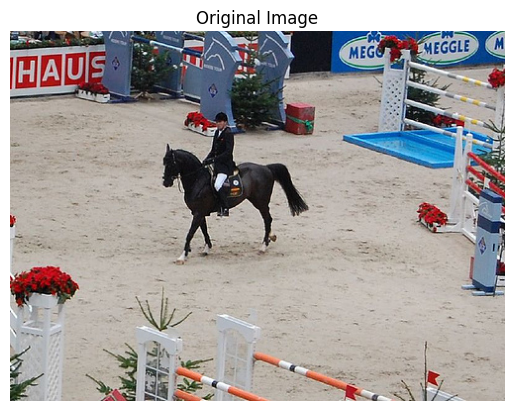

In [ ]:
image_path = '/content/Example_Pascal_VOC.jpg'  # Change this to your image path
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image_rgb)
plt.title('Original Image')
plt.axis('off')
plt.show()


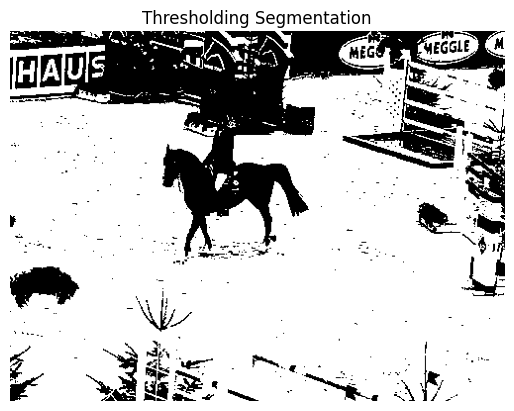

In [ ]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
_, thresh_segment = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
plt.imshow(thresh_segment, cmap='gray')
plt.title('Thresholding Segmentation')
plt.axis('off')
plt.show()


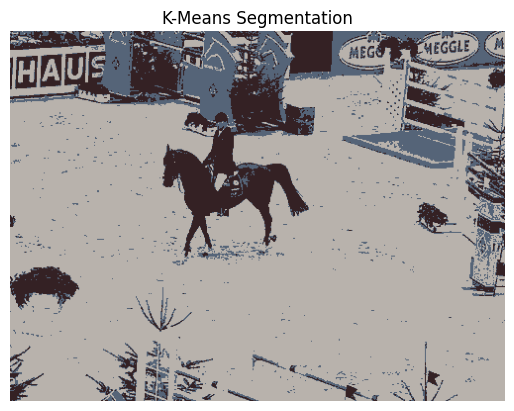

In [ ]:
pixels = image_rgb.reshape((-1, 3))
kmeans = KMeans(n_clusters=3)
kmeans.fit(pixels)
segmented = kmeans.cluster_centers_[kmeans.labels_].reshape(image_rgb.shape).astype(np.uint8)
plt.imshow(segmented)
plt.title('K-Means Segmentation')
plt.axis('off')
plt.show()


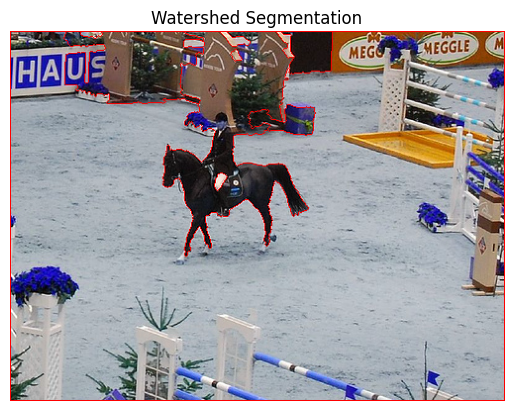

In [ ]:
gray_blur = cv2.GaussianBlur(gray, (5, 5), 0)
ret, binary = cv2.threshold(gray_blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# Markers for watershed
kernel = np.ones((3, 3), np.uint8)
sure_bg = cv2.dilate(binary, kernel, iterations=2)
dist_transform = cv2.distanceTransform(binary, cv2.DIST_L2, 5)
ret, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)
sure_fg = np.uint8(sure_fg)
unknown = cv2.subtract(sure_bg, sure_fg)
ret, markers = cv2.connectedComponents(sure_fg)
markers = markers + 1
markers[unknown == 255] = 0

markers = cv2.watershed(image, markers)
image[markers == -1] = [255, 0, 0]
plt.imshow(image)
plt.title('Watershed Segmentation')
plt.axis('off')
plt.show()


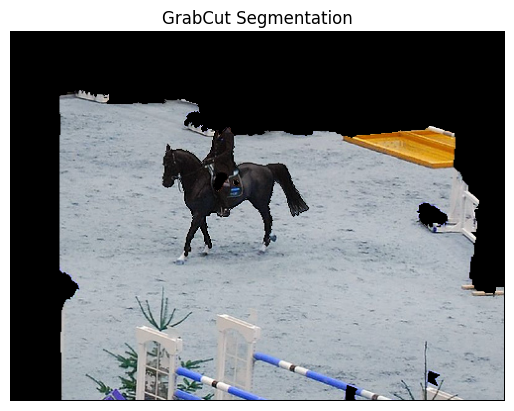

In [ ]:
mask = np.zeros(image.shape[:2], np.uint8)
bgdModel = np.zeros((1, 65), np.float64)
fgdModel = np.zeros((1, 65), np.float64)
rect = (50, 50, image.shape[1] - 50, image.shape[0] - 50)

cv2.grabCut(image, mask, rect, bgdModel, fgdModel, 5, cv2.GC_INIT_WITH_RECT)
mask2 = np.where((mask == 2) | (mask == 0), 0, 1).astype('uint8')
image_grabcut = image * mask2[:, :, np.newaxis]
plt.imshow(image_grabcut)
plt.title('GrabCut Segmentation')
plt.axis('off')
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


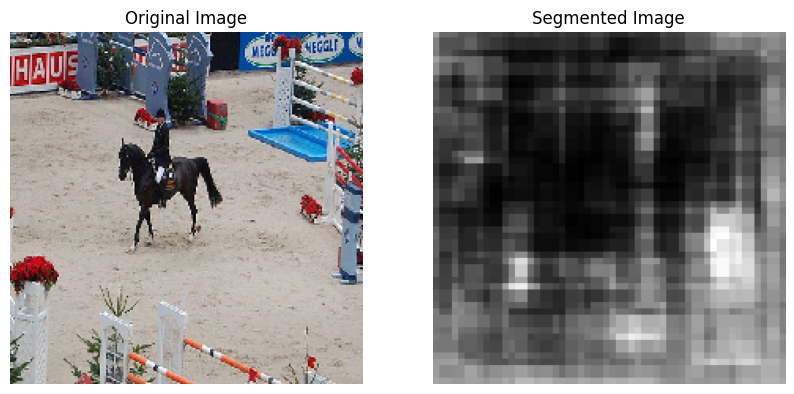

In [ ]:
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras import layers, models

# Load MobileNetV2 without the top layer
base_model = MobileNetV2(input_shape=(224, 224, 3), include_top=False, weights='imagenet')

# Add upsampling layers for segmentation
x = base_model.output
x = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(x)
x = layers.UpSampling2D((2, 2))(x)
x = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(x)
x = layers.UpSampling2D((4, 4))(x)
x = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(x)
x = layers.UpSampling2D((4, 4))(x)
segmentation_output = layers.Conv2D(1, (1, 1), activation='sigmoid')(x)

# Create the segmentation model
model = models.Model(inputs=base_model.input, outputs=segmentation_output)

# Load a test image and preprocess
test_image = tf.keras.preprocessing.image.load_img('/content/Example_Pascal_VOC.jpg', target_size=(224, 224))
input_image = tf.keras.preprocessing.image.img_to_array(test_image) / 255.0
input_image = tf.expand_dims(input_image, axis=0)

# Get predictions
predictions = model.predict(input_image)
segmented_image = predictions[0].squeeze()  # Remove extra dimensions

# Display the segmented image
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(test_image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(segmented_image, cmap='gray')
plt.title('Segmented Image')
plt.axis('off')

plt.show()


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 710ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 573ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 574ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 921ms/

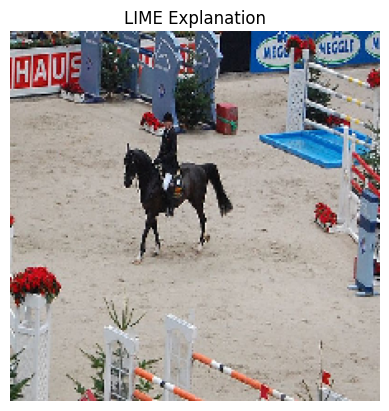

In [ ]:
import numpy as np
from lime import lime_image
import matplotlib.pyplot as plt

# Ensure input image has the correct shape (height, width, channels)
input_image_np = np.squeeze(input_image[0].numpy())  # Removes unnecessary dimensions

# Define a simplified prediction function for LIME
def predict_fn(images):
    images = np.array(images)
    if images.ndim == 3:  # If single image, add batch dimension
        images = np.expand_dims(images, axis=0)
    predictions = model.predict(images)  # Output shape: (batch_size, height, width, num_classes)

    # Flatten the predictions to a 2D array (batch_size, num_classes)
    predictions = predictions.reshape(predictions.shape[0], -1)
    return predictions

# Create the LIME explainer and generate an explanation
explainer = lime_image.LimeImageExplainer()
explanation = explainer.explain_instance(input_image_np, predict_fn, top_labels=5, hide_color=0)

# Get the explanation image and mask
lime_image, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, hide_rest=False)

# Display the LIME explanation
plt.imshow(lime_image)
plt.title('LIME Explanation')
plt.axis('off')
plt.show()


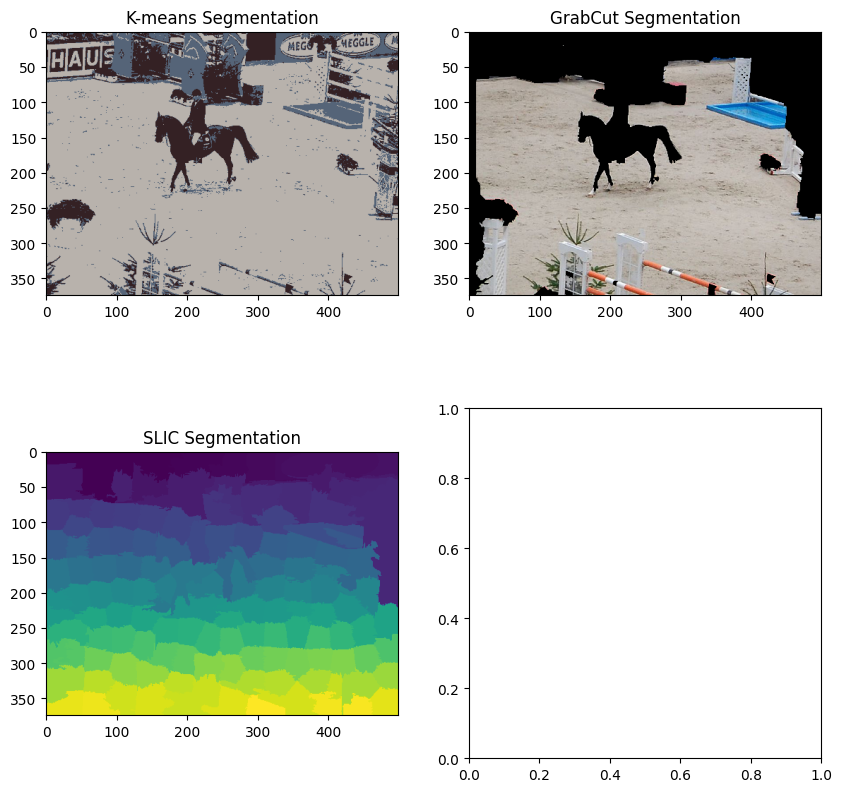

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from skimage.segmentation import slic
from skimage import color
import shap
from lime.lime_image import LimeImageExplainer

# Read the image
image = cv2.imread('/content/Example_Pascal_VOC.jpg')
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# 1. K-means Clustering Segmentation
def kmeans_segmentation(image, n_clusters=3):
    image_flat = image.reshape((-1, 3))
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(image_flat)
    segmented_image = kmeans.cluster_centers_[kmeans.labels_].reshape(image.shape)
    return segmented_image.astype(np.uint8)

kmeans_segmented = kmeans_segmentation(image_rgb)

# 2. GrabCut Segmentation
def grabcut_segmentation(image):
    mask = np.zeros(image.shape[:2], np.uint8)
    bgd_model = np.zeros((1, 65), np.float64)
    fgd_model = np.zeros((1, 65), np.float64)
    rect = (10, 10, image.shape[1]-10, image.shape[0]-10)  # Initial rectangle for foreground
    cv2.grabCut(image, mask, rect, bgd_model, fgd_model, 5, cv2.GC_INIT_WITH_RECT)
    mask2 = np.where((mask == 2) | (mask == 0), 0, 1)  # Set background to 0
    segmented_image = image * mask2[:, :, np.newaxis]
    return segmented_image

grabcut_segmented = grabcut_segmentation(image_rgb)

# 3. Superpixels Segmentation (SLIC)
def slic_segmentation(image):
    segments = slic(image, n_segments=200, compactness=10, start_label=1)
    return segments

slic_segments = slic_segmentation(image_rgb)

# 4. U-Net (if available, otherwise skip)
# Assuming a pre-trained U-Net model, you'd use:
# unet_segmented = unet_model.predict(image)

# Displaying results
fig, axs = plt.subplots(2, 2, figsize=(10, 10))

axs[0, 0].imshow(kmeans_segmented)
axs[0, 0].set_title('K-means Segmentation')

axs[0, 1].imshow(grabcut_segmented)
axs[0, 1].set_title('GrabCut Segmentation')

axs[1, 0].imshow(slic_segments)
axs[1, 0].set_title('SLIC Segmentation')

# axs[1, 1].imshow(unet_segmented)  # Uncomment when U-Net is available
# axs[1, 1].set_title('U-Net Segmentation')

plt.show()


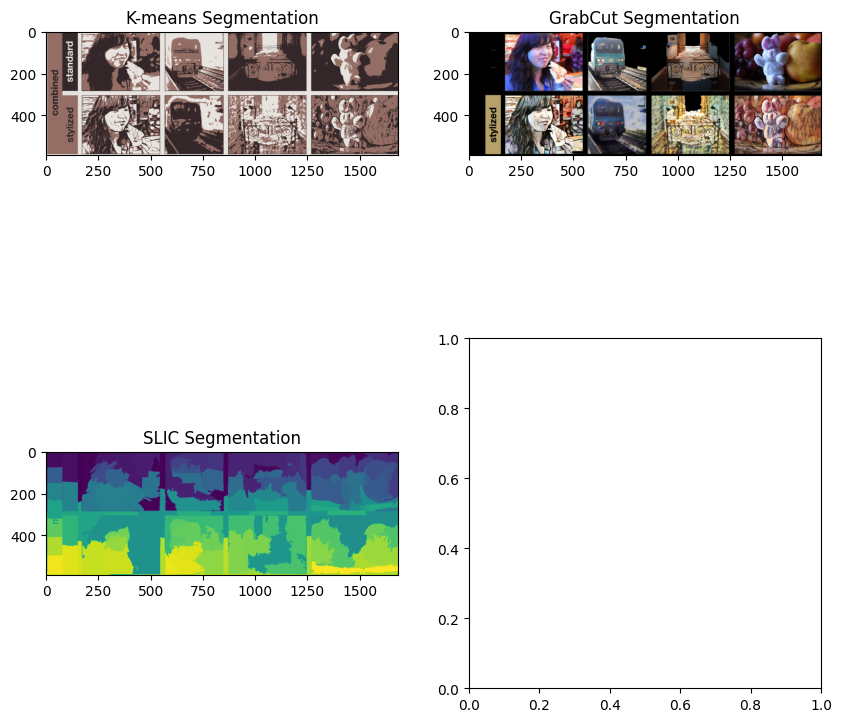

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from skimage.segmentation import slic
from skimage import color
import shap
from lime.lime_image import LimeImageExplainer

# Read the image
image = cv2.imread('/content/stylization_figure.png')
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# 1. K-means Clustering Segmentation
def kmeans_segmentation(image, n_clusters=3):
    image_flat = image.reshape((-1, 3))
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(image_flat)
    segmented_image = kmeans.cluster_centers_[kmeans.labels_].reshape(image.shape)
    return segmented_image.astype(np.uint8)

kmeans_segmented = kmeans_segmentation(image_rgb)

# 2. GrabCut Segmentation
def grabcut_segmentation(image):
    mask = np.zeros(image.shape[:2], np.uint8)
    bgd_model = np.zeros((1, 65), np.float64)
    fgd_model = np.zeros((1, 65), np.float64)
    rect = (10, 10, image.shape[1]-10, image.shape[0]-10)  # Initial rectangle for foreground
    cv2.grabCut(image, mask, rect, bgd_model, fgd_model, 5, cv2.GC_INIT_WITH_RECT)
    mask2 = np.where((mask == 2) | (mask == 0), 0, 1)  # Set background to 0
    segmented_image = image * mask2[:, :, np.newaxis]
    return segmented_image

grabcut_segmented = grabcut_segmentation(image_rgb)

# 3. Superpixels Segmentation (SLIC)
def slic_segmentation(image):
    segments = slic(image, n_segments=200, compactness=10, start_label=1)
    return segments

slic_segments = slic_segmentation(image_rgb)

# 4. U-Net (if available, otherwise skip)
# Assuming a pre-trained U-Net model, you'd use:
# unet_segmented = unet_model.predict(image)

# Displaying results
fig, axs = plt.subplots(2, 2, figsize=(10, 10))

axs[0, 0].imshow(kmeans_segmented)
axs[0, 0].set_title('K-means Segmentation')

axs[0, 1].imshow(grabcut_segmented)
axs[0, 1].set_title('GrabCut Segmentation')

axs[1, 0].imshow(slic_segments)
axs[1, 0].set_title('SLIC Segmentation')

# axs[1, 1].imshow(unet_segmented)  # Uncomment when U-Net is available
# axs[1, 1].set_title('U-Net Segmentation')

plt.show()


In [ ]:
import numpy as np

# Check the shape of the input image
print(f"Shape of image_rgb: {image_rgb.shape}")

# Assuming 'predict_fn' is the model's prediction function, let's check how it handles input:
# Let's call the prediction function with a batch of size 1 (since LIME works on batches)
sample_input = np.expand_dims(image_rgb, axis=0)  # Ensure it's a batch of shape (1, height, width, channels)

# Check the shape of the output from the model's prediction function
predictions = predict_fn(sample_input)
print(f"Shape of model predictions: {predictions.shape}")

# Check the number of samples LIME expects
# LIME samples perturbations from the input, check how many samples it's trying to generate
num_samples = 1000
print(f"Expected number of samples for LIME: {num_samples}")


Shape of image_rgb: (1, 590, 1685, 3)
Shape of model predictions: (1, 10)
Expected number of samples for LIME: 1000


In [ ]:
image = cv2.imread('/content/Example_Pascal_VOC.jpg')  # Correct image file path
if image is None:
    print("Error: Image could not be loaded. Check the file path.")
else:
    image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # Continue with your processing...


In [ ]:
print(df.shape)


(9999, 785)


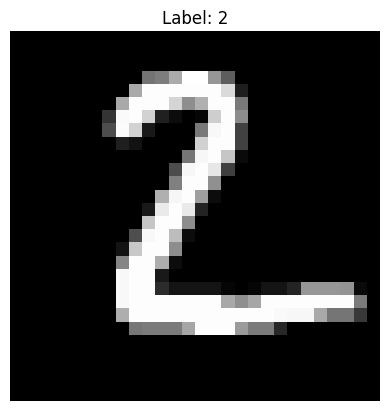

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Read the CSV file (adjust path accordingly)
df = pd.read_csv('/content/sample_data/mnist_test.csv')

# Separate the image data and labels
image_data = df.iloc[:, 1:].values  # All columns except the first one (784 values per image)
labels = df.iloc[:, 0].values  # The first column is the label

# Reshape the first image (for example)
image = image_data[0].reshape((28, 28))  # Reshape the 784 pixels into a 28x28 image

# Display the image
plt.imshow(image, cmap='gray')
plt.title(f'Label: {labels[0]}')
plt.axis('off')
plt.show()


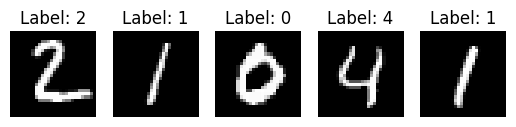

In [ ]:
for i in range(5):  # Display the first 5 images
    image = image_data[i].reshape((28, 28))
    plt.subplot(1, 5, i+1)
    plt.imshow(image, cmap='gray')
    plt.title(f'Label: {labels[i]}')
    plt.axis('off')

plt.show()


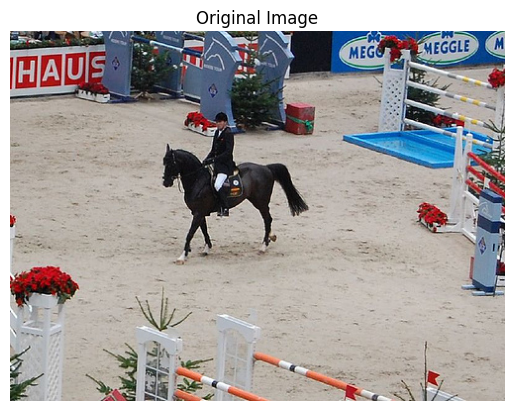

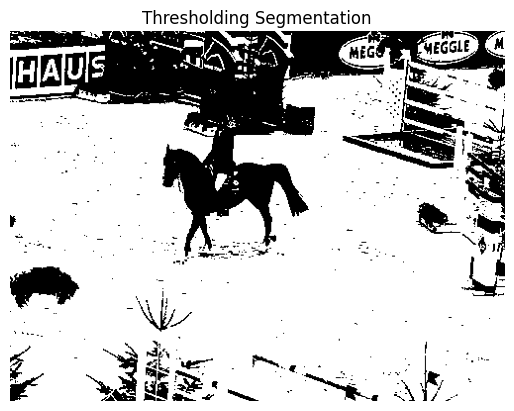

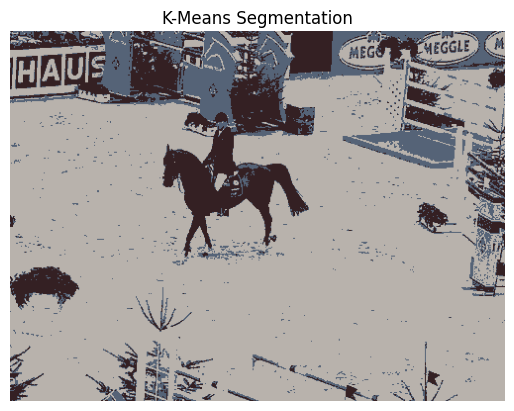

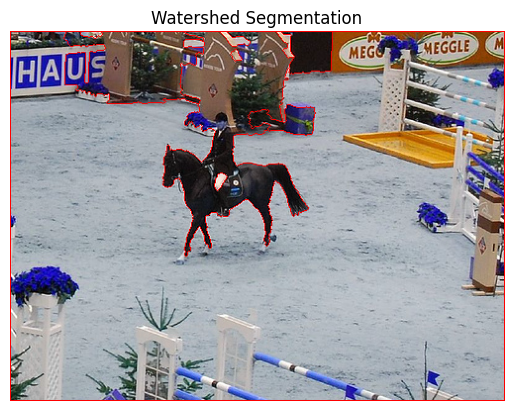

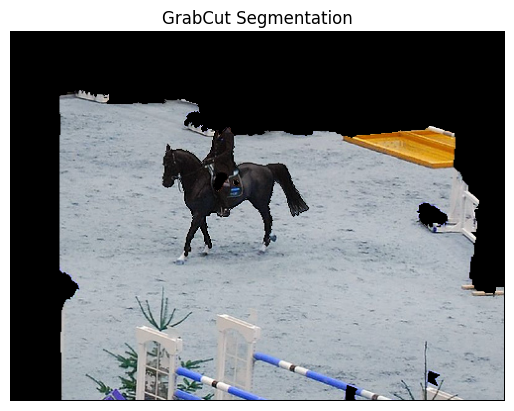

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


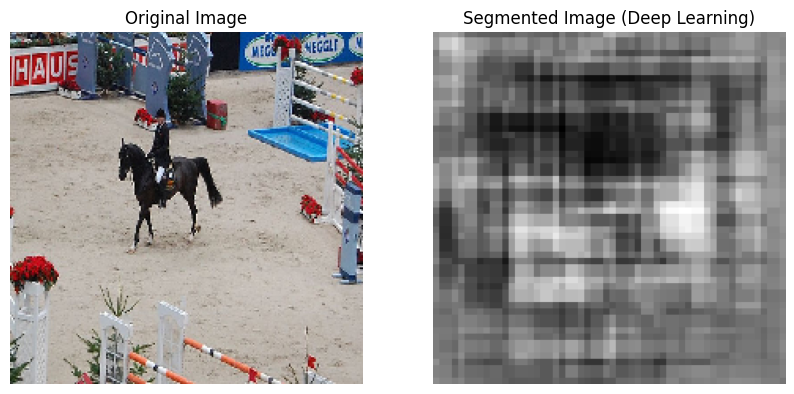

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras import layers, models
from lime import lime_image
import shap

# Load the image
image_path = '/content/Example_Pascal_VOC.jpg'  # Change this to your image path
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Display Original Image
plt.imshow(image_rgb)
plt.title('Original Image')
plt.axis('off')
plt.show()

# 1. Thresholding Segmentation
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
_, thresh_segment = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
plt.imshow(thresh_segment, cmap='gray')
plt.title('Thresholding Segmentation')
plt.axis('off')
plt.show()

# 2. K-means Clustering
pixels = image_rgb.reshape((-1, 3))
kmeans = KMeans(n_clusters=3)
kmeans.fit(pixels)
segmented_kmeans = kmeans.cluster_centers_[kmeans.labels_].reshape(image_rgb.shape).astype(np.uint8)
plt.imshow(segmented_kmeans)
plt.title('K-Means Segmentation')
plt.axis('off')
plt.show()

# 3. Watershed Segmentation
gray_blur = cv2.GaussianBlur(gray, (5, 5), 0)
ret, binary = cv2.threshold(gray_blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
kernel = np.ones((3, 3), np.uint8)
sure_bg = cv2.dilate(binary, kernel, iterations=2)
dist_transform = cv2.distanceTransform(binary, cv2.DIST_L2, 5)
ret, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)
sure_fg = np.uint8(sure_fg)
unknown = cv2.subtract(sure_bg, sure_fg)
ret, markers = cv2.connectedComponents(sure_fg)
markers = markers + 1
markers[unknown == 255] = 0

markers = cv2.watershed(image, markers)
image[markers == -1] = [255, 0, 0]
plt.imshow(image)
plt.title('Watershed Segmentation')
plt.axis('off')
plt.show()

# 4. GrabCut Segmentation
mask = np.zeros(image.shape[:2], np.uint8)
bgdModel = np.zeros((1, 65), np.float64)
fgdModel = np.zeros((1, 65), np.float64)
rect = (50, 50, image.shape[1] - 50, image.shape[0] - 50)
cv2.grabCut(image, mask, rect, bgdModel, fgdModel, 5, cv2.GC_INIT_WITH_RECT)
mask2 = np.where((mask == 2) | (mask == 0), 0, 1).astype('uint8')
image_grabcut = image * mask2[:, :, np.newaxis]
plt.imshow(image_grabcut)
plt.title('GrabCut Segmentation')
plt.axis('off')
plt.show()

# 5. Deep Learning-based Segmentation using MobileNetV2
base_model = MobileNetV2(input_shape=(224, 224, 3), include_top=False, weights='imagenet')
x = base_model.output
x = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(x)
x = layers.UpSampling2D((2, 2))(x)
x = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(x)
x = layers.UpSampling2D((4, 4))(x)
x = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(x)
x = layers.UpSampling2D((4, 4))(x)
segmentation_output = layers.Conv2D(1, (1, 1), activation='sigmoid')(x)

model = models.Model(inputs=base_model.input, outputs=segmentation_output)

# Preprocessing image for deep learning
test_image = tf.keras.preprocessing.image.load_img(image_path, target_size=(224, 224))
input_image = tf.keras.preprocessing.image.img_to_array(test_image) / 255.0
input_image = tf.expand_dims(input_image, axis=0)

# Get predictions
predictions = model.predict(input_image)
segmented_image = predictions[0].squeeze()  # Remove extra dimensions

# Display Deep Learning Segmentation result
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(test_image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(segmented_image, cmap='gray')
plt.title('Segmented Image (Deep Learning)')
plt.axis('off')

plt.show()



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 601ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 825ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 950ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 573ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 957ms/

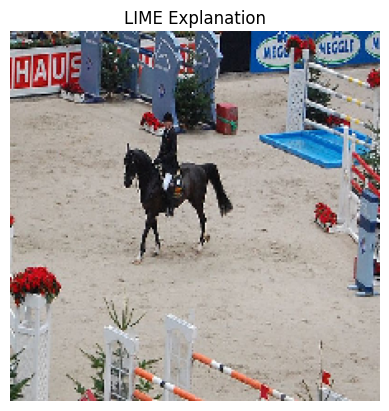

In [ ]:
import numpy as np
import tensorflow as tf
from lime import lime_image

# Convert the input image to NumPy array
input_image = input_image.numpy()  # Convert from TensorFlow tensor to NumPy array

# Update the predict_fn to handle NumPy arrays and return predictions
def predict_fn(images):
    images = np.array(images)  # Ensure images is a NumPy array
    if images.ndim == 3:  # If single image, add batch dimension
        images = np.expand_dims(images, axis=0)
    predictions = model.predict(images)
    predictions = predictions.reshape(predictions.shape[0], -1)  # Flatten the predictions
    return predictions

# Use LIME to explain the segmentation
explainer = lime_image.LimeImageExplainer()
explanation = explainer.explain_instance(input_image[0], predict_fn, top_labels=5, hide_color=0)

# Get the LIME image explanation
lime_image_result, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, hide_rest=False)

# Display the LIME explanation
plt.imshow(lime_image_result)
plt.title('LIME Explanation')
plt.axis('off')
plt.show()


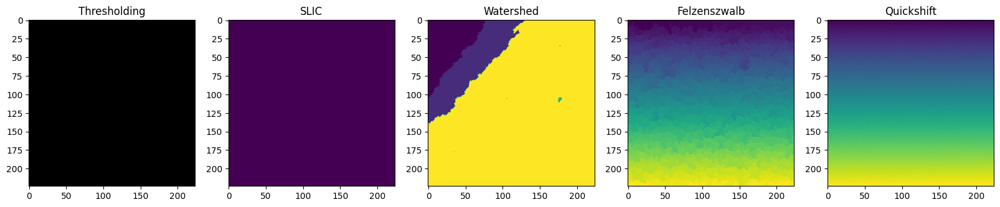

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
from torchvision import transforms, models
import shap
from lime.lime_image import LimeImageExplainer
from skimage import segmentation, color
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import cv2

# Sample data paths for image segmentation and explainability tools
data_paths = [
    '/content/sample_data/california_housing_train.csv',
    '/content/sample_data/california_housing_test.csv',
    '/content/sample_data/mnist_train_small.csv',
    '/content/sample_data/mnist_test.csv'
]

# Define transformations that work directly with Tensors
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize if necessary
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # Normalization for RGB
])

# Example of creating a sample input image
single_image = torch.rand(3, 224, 224)  # Simulated RGB image with random values

# Transform and normalize the single image
transformed_image = transform(single_image)

# Move to the appropriate device if needed (e.g., GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
transformed_image = transformed_image.to(device)

# Segmentation using different tools

# 1. Simple Thresholding (using OpenCV)
gray_image = cv2.cvtColor(single_image.permute(1, 2, 0).cpu().numpy(), cv2.COLOR_RGB2GRAY)
_, thresholded = cv2.threshold(gray_image, 127, 255, cv2.THRESH_BINARY)

# 2. SLIC (Simple Linear Iterative Clustering) Segmentation (skimage)
segments_slic = segmentation.slic(single_image.permute(1, 2, 0).cpu().numpy(), n_segments=100, compactness=10)

# 3. Watershed Segmentation (skimage)
gradient = np.gradient(gray_image)
watershed_segments = segmentation.watershed(gradient[0] + gradient[1], markers=10, connectivity=1)

# 4. Felzenszwalb Segmentation (skimage)
segments_felzenszwalb = segmentation.felzenszwalb(single_image.permute(1, 2, 0).cpu().numpy(), scale=1.0, sigma=0.5)

# 5. Quickshift Segmentation (skimage)
segments_quickshift = segmentation.quickshift(single_image.permute(1, 2, 0).cpu().numpy(), kernel_size=3, max_dist=6, ratio=0.5)

# Visualizing the segmentation results
fig, axes = plt.subplots(1, 5, figsize=(20, 5))
axes[0].imshow(thresholded, cmap='gray')
axes[0].set_title("Thresholding")
axes[1].imshow(segments_slic)
axes[1].set_title("SLIC")
axes[2].imshow(watershed_segments)
axes[2].set_title("Watershed")
axes[3].imshow(segments_felzenszwalb)
axes[3].set_title("Felzenszwalb")
axes[4].imshow(segments_quickshift)
axes[4].set_title("Quickshift")
plt.show()



In [ ]:
print("Training data shape:", X_housing_train.shape)
print("Test data shape:", X_housing_test_aligned_df.shape)


Training data shape: (17000, 4)
Test data shape: (3000, 4)


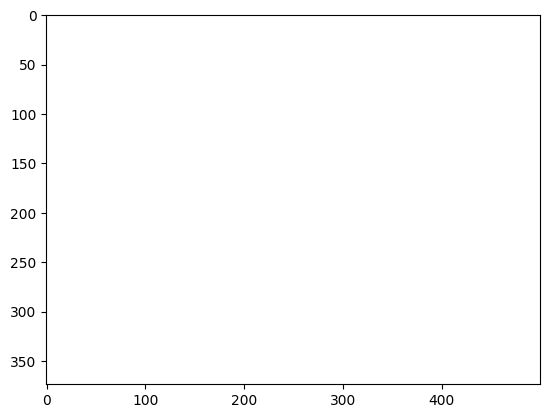

In [ ]:
import cv2
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Load image
image = cv2.imread('/content/Example_Pascal_VOC.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Flatten the image for clustering
pixels = image.reshape((-1, 3))

# Apply K-means Clustering
kmeans = KMeans(n_clusters=3)
kmeans.fit(pixels)

# Reshape the result back into the image
segmented_image = kmeans.cluster_centers_[kmeans.labels_].reshape(image.shape)

# Display the segmented image
plt.imshow(segmented_image)
plt.show()


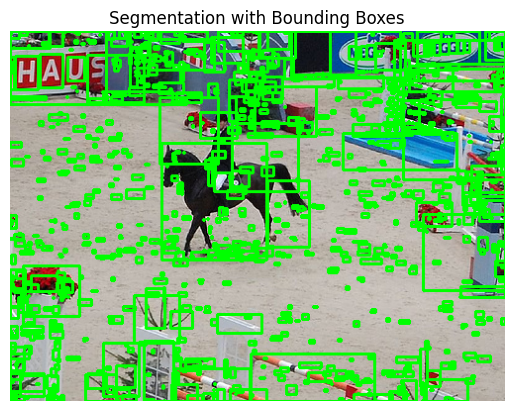

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load image
image = cv2.imread('/content/Example_Pascal_VOC.jpg')
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply Canny edge detection
edges = cv2.Canny(gray, 100, 200)

# Find contours of the detected edges
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Draw bounding boxes around detected contours
output_image = image.copy()
for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)
    cv2.rectangle(output_image, (x, y), (x + w, y + h), (0, 255, 0), 2)

# Display the result
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))
plt.title("Segmentation with Bounding Boxes")
plt.axis('off')
plt.show()


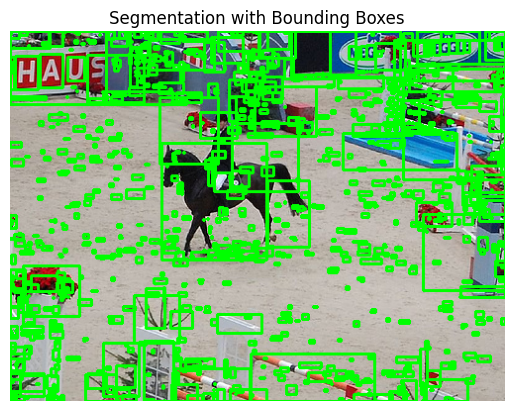

  0%|          | 0/1000 [00:00<?, ?it/s]

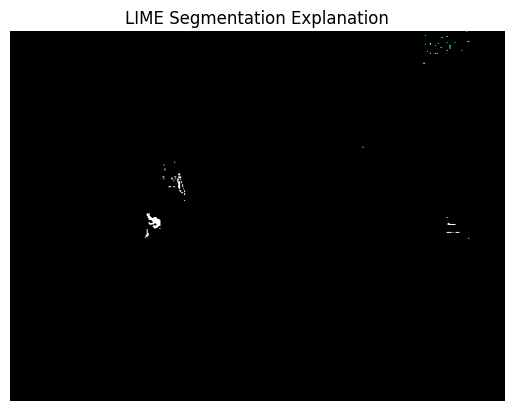

  0%|          | 0/1 [00:00<?, ?it/s]

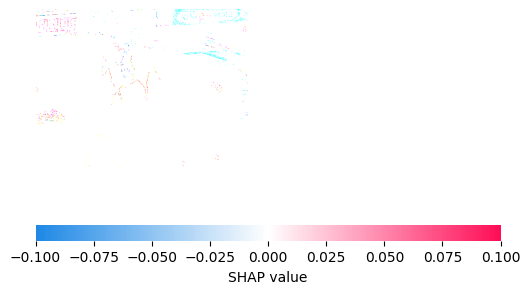

In [ ]:
!pip install lime
!pip install shap
import cv2
import numpy as np
import matplotlib.pyplot as plt
import shap
import lime
from lime import lime_image
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import load_digits

# Load image and convert to grayscale
image = cv2.imread('/content/Example_Pascal_VOC.jpg')
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply Canny edge detection for segmentation
edges = cv2.Canny(gray, 100, 200)

# Find contours of the detected edges
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Draw bounding boxes around detected contours
output_image = image.copy()
for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)
    cv2.rectangle(output_image, (x, y), (x + w, y + h), (0, 255, 0), 2)

# Display the segmentation result (bounding boxes)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))
plt.title("Segmentation with Bounding Boxes")
plt.axis('off')
plt.show()

# 2. LIME Interpretation (for Image Segmentation)
# Assuming we have a model (classifier) for segmentation predictions
# For this example, let's create a mock classifier based on pixel features

# Mock model (replace with your actual segmentation model)
def mock_classifier(X):
    # Ensure at least one prediction is 1 for demonstration purposes
    result = np.random.randint(2, size=(X.shape[0], 1))
    result[0, 0] = 1  # Force the first prediction to be 1
    return result

# Define LIME image explainer
explainer = lime_image.LimeImageExplainer()

# Example input: image (reshape for LIME input)
image_input = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Use the original image for explanation
image_input = np.array(image_input, dtype=np.float32)

# Apply LIME explanation
explanation = explainer.explain_instance(image_input, mock_classifier, top_labels=2, hide_color=0, num_samples=1000) # Change top_labels to 2 to include both labels

# Dynamic Label Selection:
# Get the actual predicted labels from the explanation object
labels_in_explanation = list(explanation.local_exp.keys())

# Choose a label that is actually present in the explanation
label_to_visualize = labels_in_explanation[0]  # Select the first available label

# Visualize LIME explanation for the selected label
temp, mask = explanation.get_image_and_mask(label_to_visualize, positive_only=True, num_features=5, hide_rest=True)

plt.imshow(temp)
plt.title("LIME Segmentation Explanation")
plt.axis('off')
plt.show()

# 3. SHAP Interpretation (for Image Segmentation)
# Using SHAP to interpret the model's output

# SHAP Explainer: we need to explain how the model behaves for the given input
# Create SHAP explainer (KernelExplainer for image data)
shap_explainer = shap.KernelExplainer(mock_classifier, image_input.flatten().reshape(1, -1))

# Calculate SHAP values
shap_values = shap_explainer.shap_values(image_input.flatten().reshape(1, -1))

# Visualize SHAP values on the image (output will be a heatmap)
shap.image_plot(shap_values, image_input)